# ScRNA-seq analysis of the PCW3 samples

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import time

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=150)

import scvelo as scv
scv.logging.print_version()
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.set_figure_params('scvelo')  # for beautified visualization

/datb/home/wanglab13/anaconda3/envs/r2/lib/python3.6/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


Running scvelo 0.1.24 (python 3.6.7) on 2021-08-06 16:16.


In [2]:
week_files = ['/newdatb/lzy/human_whole_brain/alignment/agg_3W-1/HE-6_aggr_out/outs/filtered_gene_bc_matrices_mex/hg19/']
out_dir = '/newdatb/home/wanglab13/scratch/wholebrain/results'
week_stages = [wf.split('/')[5].split('_')[1] for wf in week_files]
adata_files = [os.path.join(out_dir,'h5ad','{}_nopreproc.h5ad'.format(week_stage)) for week_stage in week_stages]
start_time = time.time()
[adataw3_1] = [sc.read(adata_file) for adata_file in adata_files]
print("--- %s seconds ---" % (time.time() - start_time))

--- 0.2684967517852783 seconds ---


In [3]:
adataw3_1.obs['week_stage']='W3-1'

filtered out 10788 genes that are detected in less than 3 cells
... storing 'week_stage' as categorical


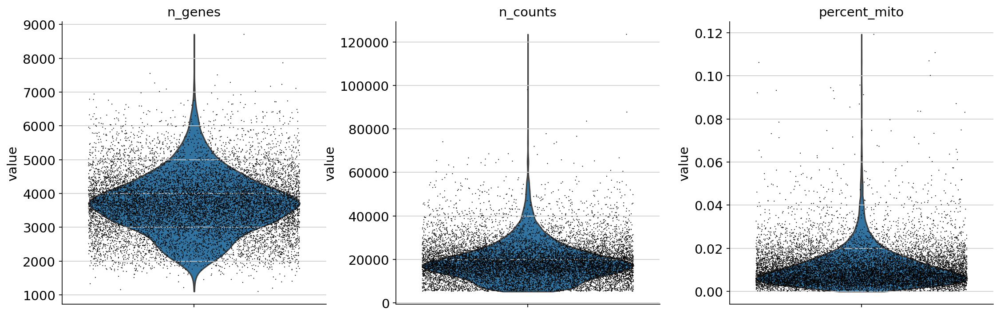

In [4]:
sc.pp.filter_cells(adataw3_1, min_genes=200)
sc.pp.filter_genes(adataw3_1, min_cells=3)

mito_genes = adataw3_1.var_names.str.startswith('MT-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adataw3_1.obs['percent_mito'] = np.sum(
    adataw3_1[:, mito_genes].X, axis=1) / np.sum(adataw3_1.X, axis=1)
# add the total counts per cell as observations-annotation to adataw3_1
adataw3_1.obs['n_counts'] = adataw3_1.X.sum(axis=1)
sc.pl.violin(adataw3_1, ['n_genes', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

In [5]:
adataw3_1 = adataw3_1[(adataw3_1.obs['n_genes'] > 800) & (adataw3_1.obs['n_genes'] < 6000), :]
sc.pp.normalize_per_cell(adataw3_1, counts_per_cell_after=1e4)

sc.pp.log1p(adataw3_1)
adataw3_1.raw=adataw3_1.copy()

sc.pp.highly_variable_genes(adataw3_1, min_mean=0.0125, max_mean=3, min_disp=0.5)

sc.pp.scale(adataw3_1, max_value=10)

sc.tl.pca(adataw3_1, svd_solver='arpack',use_highly_variable=True)

sc.pp.neighbors(adataw3_1, n_neighbors=10, n_pcs=40)

sc.tl.umap(adataw3_1)

sc.tl.louvain(adataw3_1)

normalizing by total count per cell
Trying to set attribute `.obs` of view, copying.
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 40
/datb/home/wanglab13/anaconda3/lib/python3.7/site-packages/numba/core/typed_passes.py:314: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see https://numba.pydata.org/numba-

/datb/home/wanglab13/anaconda3/lib/python3.7/site-packages/anndata/compat/__init__.py:182: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/datb/home/wanglab13/anaconda3/lib/python3.7/site-packages/anndata/compat/__init__.py:182: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  FutureWarning,


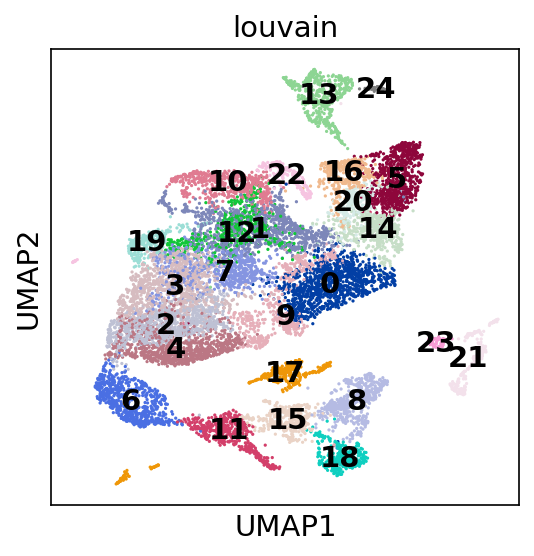

In [7]:
# adataw3_1 = sc.read(r'/newdatb/home/wanglab13/scratch/wholebrain/results/agg_HE-6-3W/scanpy/write/wholebrainw3_v3.h5ad')
sc.pl.umap(adataw3_1, color=['louvain'],legend_loc='on data')

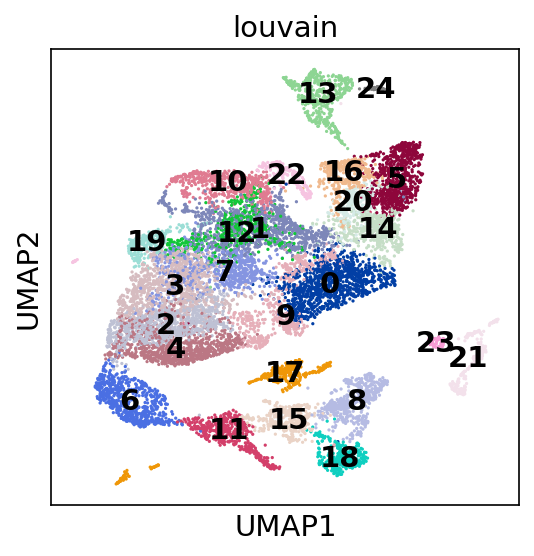

In [9]:
## remove doublet cells
df_doublets = pd.read_csv('/datb/home/wanglab13/PythonScripts/Cell_response/Updates/Data/Doublets_obs.csv')
df_doublets_w3=['-'.join([i.split('-')[0],i.split('-')[1]]) for i in df_doublets[df_doublets['week_stage']=='W3-1']['index'].values]
adataw3_1=adataw3_1[~adataw3_1.obs_names.isin(df_doublets_w3)]
sc.pl.umap(adataw3_1, color=['louvain'],legend_loc='on data')

running Louvain clustering
    using the "louvain" package of Traag (2017)
Trying to set attribute `.obs` of view, copying.
    finished: found 27 clusters and added
    'louvain_new', the cluster labels (adata.obs, categorical) (0:00:01)


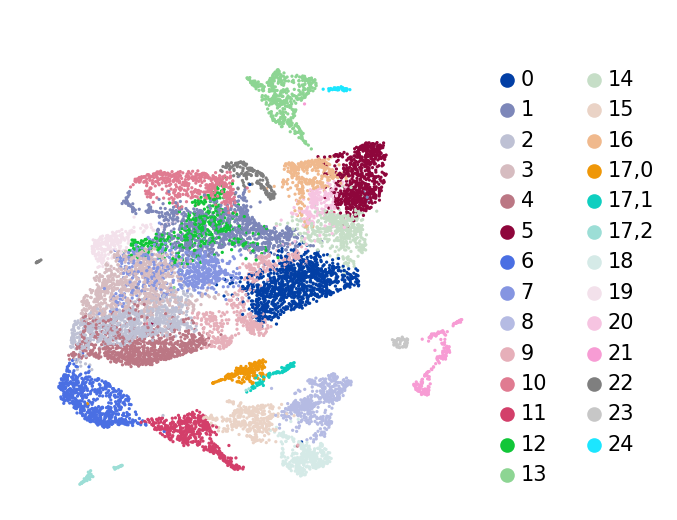

In [10]:
sc.tl.louvain(adataw3_1, restrict_to=('louvain', ['17']), resolution=0.2, key_added='louvain_new')
sc.pl.umap(adataw3_1, color=['louvain_new'],frameon=False,title=' ',legend_fontsize=10)

In [16]:
map_coarse = {}
for c in adataw3_1.obs['louvain_new'].cat.categories:
    if c in ['8']:
        map_coarse[c]='Neuralepithelial Cell 1'
    if c in ['15']:
        map_coarse[c]='Neuralepithelial Cell 2'
    if c in ['18']:
        map_coarse[c]='Neural Crest'
    if c in ['11']:
        map_coarse[c]='Neuralepithelial Cell 3'
    if c in ['6']:
        map_coarse[c]='NMP'
    if c in ['2','4']:
        map_coarse[c]='Mesoderm Precursor'
    if c in ['9']:
        map_coarse[c]='Presomitic Mesoderm'
    if c in ['0']:
        map_coarse[c]='Somite'
    if c in ['5','14','20','16']:
        map_coarse[c]='Myocyte Progenitor'
    if c in ['10']:
        map_coarse[c]='Cardiac Mesoderm'
    if c in ['1']:
        map_coarse[c]='Lateral Plate Mesoderm 2'
    if c in ['12','7']:
        map_coarse[c]='Intermedicate Mesoderm'
    if c in ['22']:
        map_coarse[c]='Cardiac Myocyte'
    if c in ['19','3']:
        map_coarse[c]='Lateral Plate Mesoderm 1'
    if c in ['17,0']:
        map_coarse[c]='Epithelium'
    if c in ['17,1']:
        map_coarse[c]='Endoderm'
    if c in ['17,2']:
        map_coarse[c]='Notochord'
    if c in ['21','23']:
        map_coarse[c]='Primitive Erythroid'
    if c in ['13','24']:
        map_coarse[c]='Endothelium'
adataw3_1.obs['clusters']=adataw3_1.obs['louvain_new']
adataw3_1.obs.replace({'clusters':map_coarse},inplace=True)

In [23]:
adataw3_1.uns['clusters_colors']=['#c49c94',
'#9edae5',
'#f7b6d2',
'#b5bd61',
'#c5b0d5',
'#279e68',
'#aa40fc',
'#e377c2',
'#d62728',
'#ff7f0e',
'#ff9896',
'#ffbb78',
'#aec7e8',
'#98df8a',
'#17becf',
'#ad494a',
'#8c564b',
'#dbdb8d',
'#1f77b4']

<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>

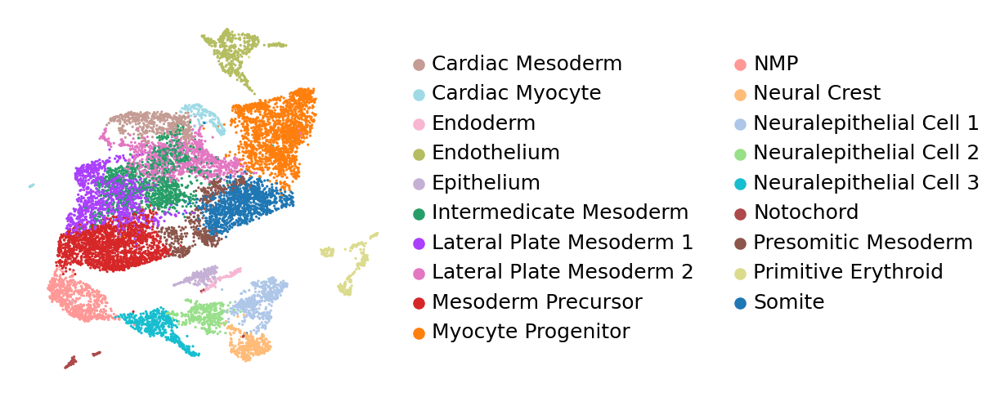

In [25]:
fig, ax = plt.subplots()
sc.pl.umap(adataw3_1,color='clusters',frameon=False,title='',legend_fontsize=12,show=False,legend_loc='right margin',ax=ax)
# plt.savefig("./paper_figures/Fig2/Fig2a_umap.pdf", dpi=300, format='pdf', bbox_inches='tight')

In [27]:
import loompy
files = ['/newdatb/lzy/human_whole_brain/alignment/3W-1_20190614/B7_FKDL190744099-1a_H2NJVCCX2_L5/B7_out/velocyto/B7_out.loom',
         '/newdatb/lzy/human_whole_brain/alignment/3W-1_20190614/B8_FKDL190744100-1a_H2NJVCCX2_L3/B8_out/velocyto/B8_out.loom']
loompy.combine(files, "/newdatb/home/wanglab13/scratch/wholebrain/results/loom/merged_w3_v1.loom", key="Accession")

In [28]:
ldata = scv.read("/newdatb/home/wanglab13/scratch/wholebrain/results/loom/merged_w3.loom", cache=False)

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [29]:
ldata.var_names_make_unique()
obs = ldata.obs_names.values
import re
weeks = ['3W-1']
dict = {}
for week in weeks:
    week_files = [str.split('/')[-3] for str in files if re.search(week+'_20',str)]
    dict[week] = week_files
wl_old = []
for j,(k,v) in enumerate(dict.items()):
    wl = []
    for i,v1 in enumerate(v):
        
        wltmp = [x.split(':')[1][0:-1]+'-{}'.format(i+1) for x in obs if x.startswith(v1)]
        print(k,v1,len(wltmp))
        wl.extend(wltmp)
    print(k,len(wl),wl[0])

    if j>=1:
        wl_old = [x+'-0' for x in wl_old]
        wl = [x+'-1' for x in wl] 
        
    if(j==0):
        wl_old=wl
    else:
        wl_old.extend(wl)

3W-1 B7_out 6257
3W-1 B8_out 6273
3W-1 12530 AAATGCCCACCTCGTT-1


In [30]:
ldata.obs_names = wl_old

In [31]:
# adataw3_1 = scv.read("/newdatb/home/wanglab13/scratch/wholebrain/results/agg_HE-6-3W/scanpy/write/wholebrainw3_v3.h5ad",catch=True)
adataw3_1 = adataw3_1[:, adataw3_1.var['highly_variable']]
adataw3_1 = scv.utils.merge(adataw3_1, ldata)
scv.pp.filter_and_normalize(adataw3_1)
scv.pp.moments(adataw3_1)
scv.tl.velocity_graph(adataw3_1)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:07) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:01:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [35]:
sc.settings.set_figure_params(dpi=150)

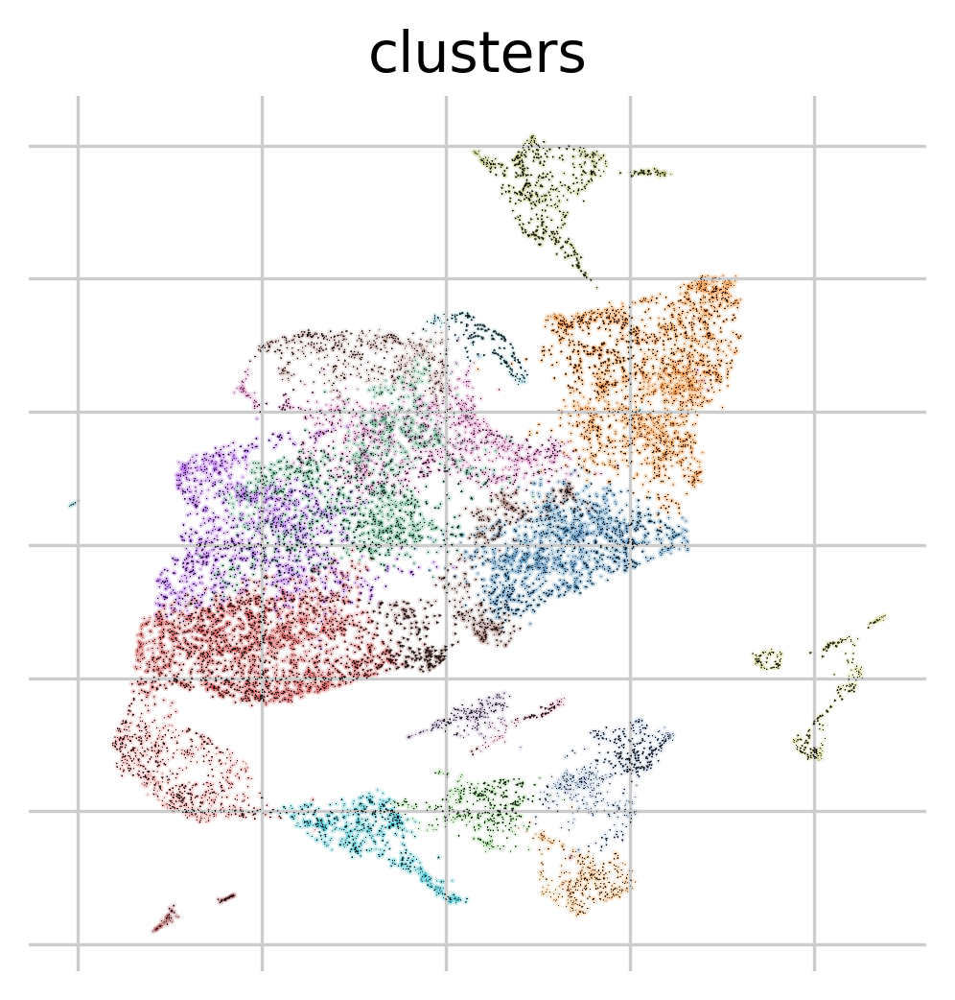

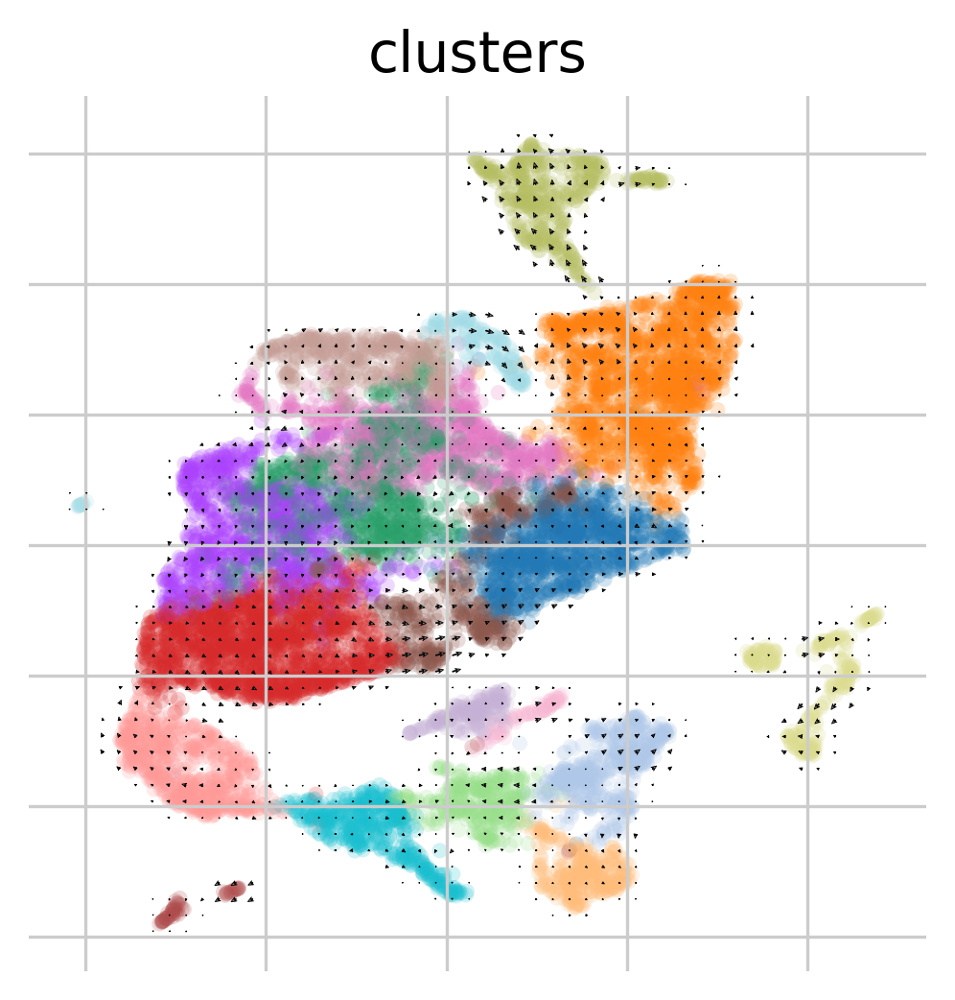

In [36]:
scv.pl.velocity_embedding(adataw3_1, basis='umap',color='clusters')
scv.pl.velocity_embedding_grid(adataw3_1, basis='umap',color='clusters',alpha=0.2)

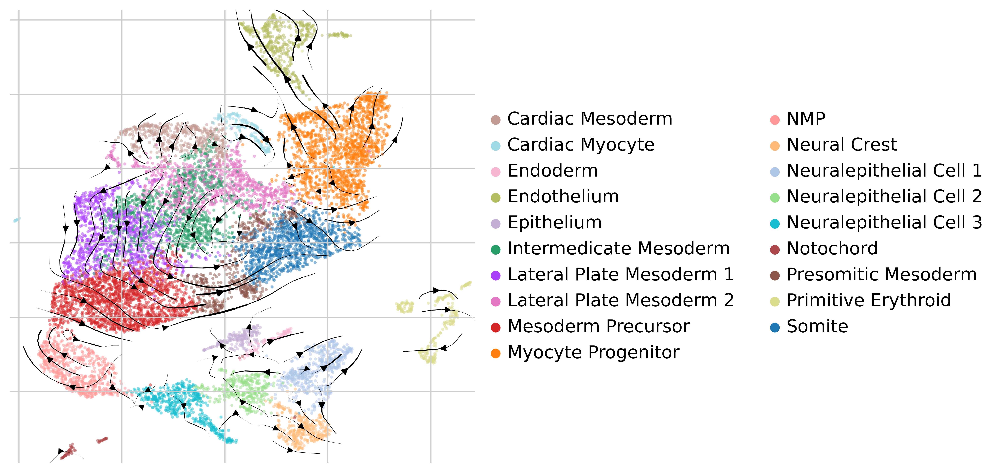

In [38]:
scv.pl.velocity_embedding_stream(adataw3_1, basis='umap',color='clusters',legend_loc='right margin',title='',linewidth=0.8,
                                 size=20,alpha=0.5,figsize=(6,6),density=0.6,smooth=0.5,min_mass=1,cutoff_perc=1,projection='2d',dpi=300)

## Fig2C

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import os
import time

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=150)

import scvelo as scv
scv.logging.print_version()
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.set_figure_params('scvelo')  # for beautified visualization

Running scvelo 0.2.3 (python 3.7.9) on 2021-08-09 14:34.


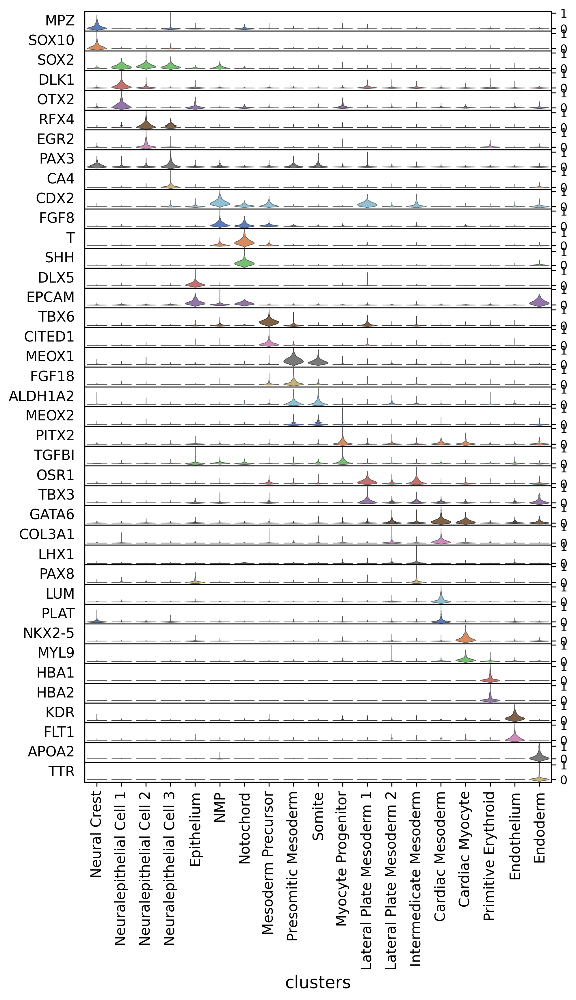

In [39]:
Neural_crest=['MPZ','SOX10']
Neuralepithelial_Cell1= ['SOX2','DLK1','OTX2']
Neuralepithelial_Cell2 = ['RFX4','EGR2']
Neuralepithelial_Cell3 = ['PAX3','CA4']
NMP = ['CDX2','FGF8']
Noto_chord=['T','SHH']
Epithelium=['DLX5','EPCAM']
Mesoderm_Precursor=['TBX6','CITED1']
Presomitic_Mesoderm=['MEOX1','FGF18']
Somite = ['ALDH1A2','MEOX2']
Myocyte_Progenitor=['PITX2','TGFBI']
Lateral_Plate_Mesoderm1=['OSR1','TBX3']
Lateral_Plate_Mesoderm2=['GATA6','COL3A1']
Intermedicate_mdeosderm=['LHX1','PAX8']
Cardiac_Mesoderm=['LUM','PLAT']
Cardiac_Myocyte=['NKX2-5','MYL9']
blood_cell=['HBA1','HBA2']
Endothelium=['KDR','FLT1']
Endoderm= ['APOA2','TTR']

markers=Neural_crest+Neuralepithelial_Cell1+Neuralepithelial_Cell2+Neuralepithelial_Cell3 +NMP+Noto_chord+Epithelium+\
Mesoderm_Precursor+Presomitic_Mesoderm+Somite+Myocyte_Progenitor+Lateral_Plate_Mesoderm1+Lateral_Plate_Mesoderm2+\
Intermedicate_mdeosderm+Cardiac_Mesoderm+Cardiac_Myocyte+blood_cell+Endothelium+Endoderm

ax = sc.pl.stacked_violin(adataw3_1, markers, groupby='clusters',use_raw=True,standard_scale='var',swap_axes=True,order=['Neural Crest','Neuralepithelial Cell 1','Neuralepithelial Cell 2','Neuralepithelial Cell 3','Epithelium','NMP','Notochord',
'Mesoderm Precursor','Presomitic Mesoderm','Somite','Myocyte Progenitor','Lateral Plate Mesoderm 1','Lateral Plate Mesoderm 2','Intermedicate Mesoderm',
'Cardiac Mesoderm','Cardiac Myocyte','Primitive Erythroid','Endothelium','Endoderm'],ylabel='clusters')

In [40]:
adataw3_1.write('./Data/W3_1.h5ad')

## FigS2A

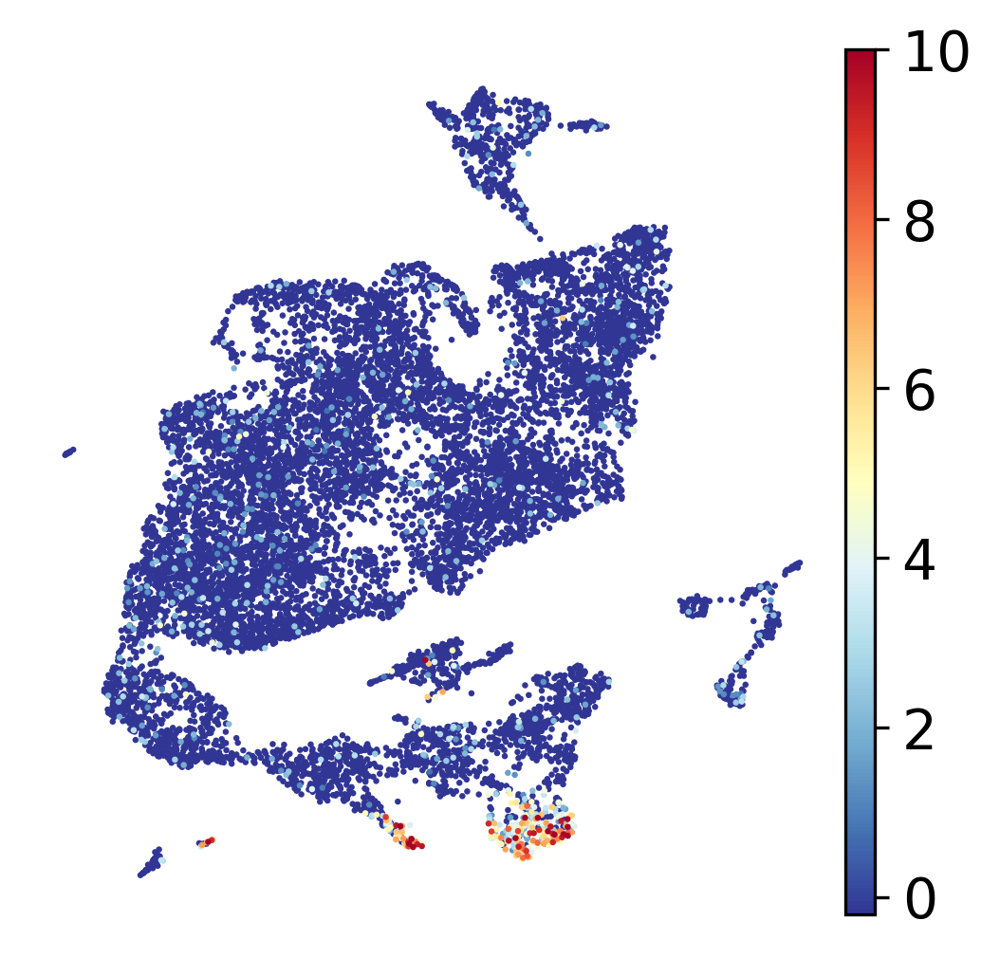

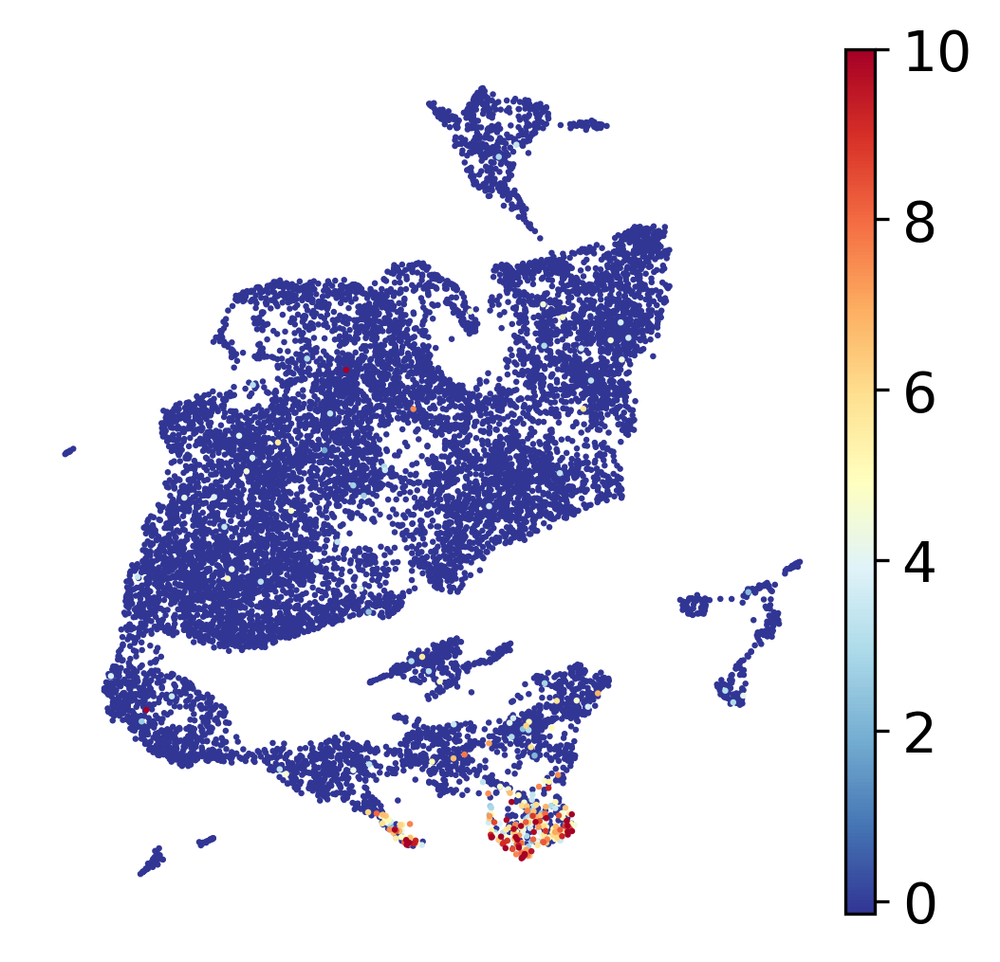

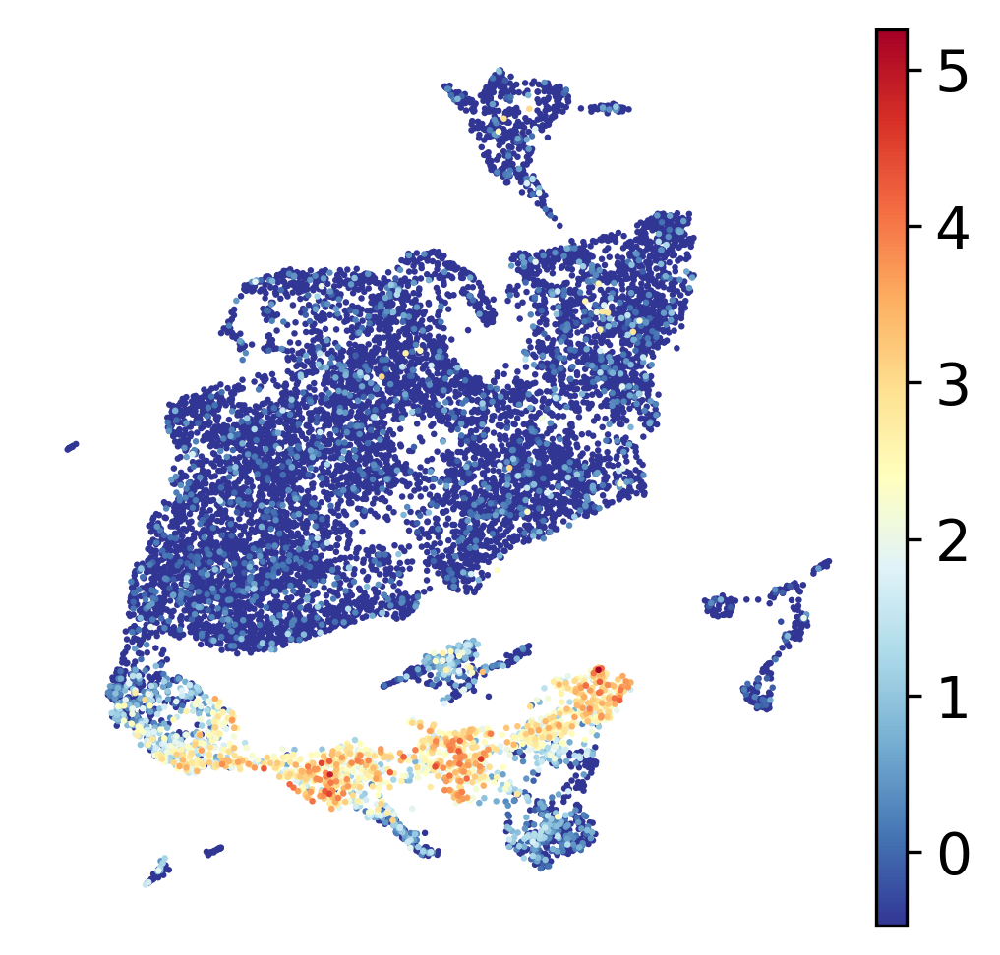

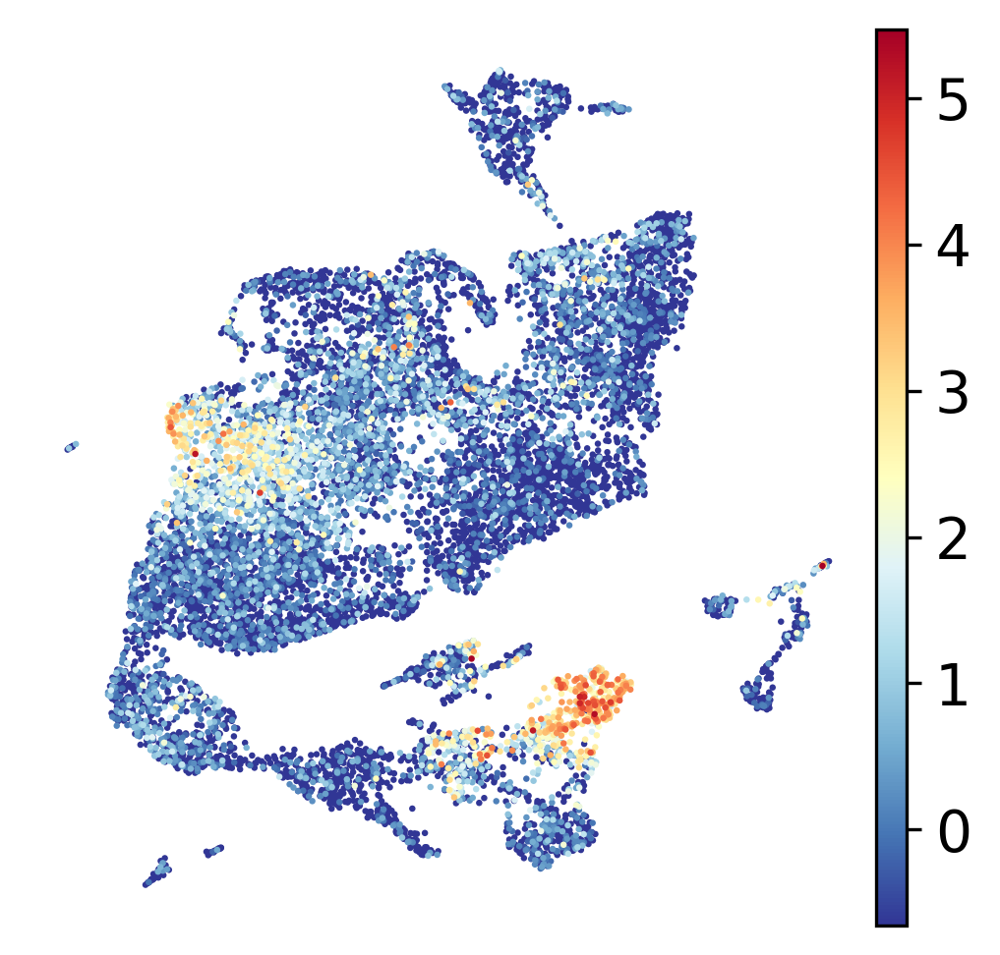

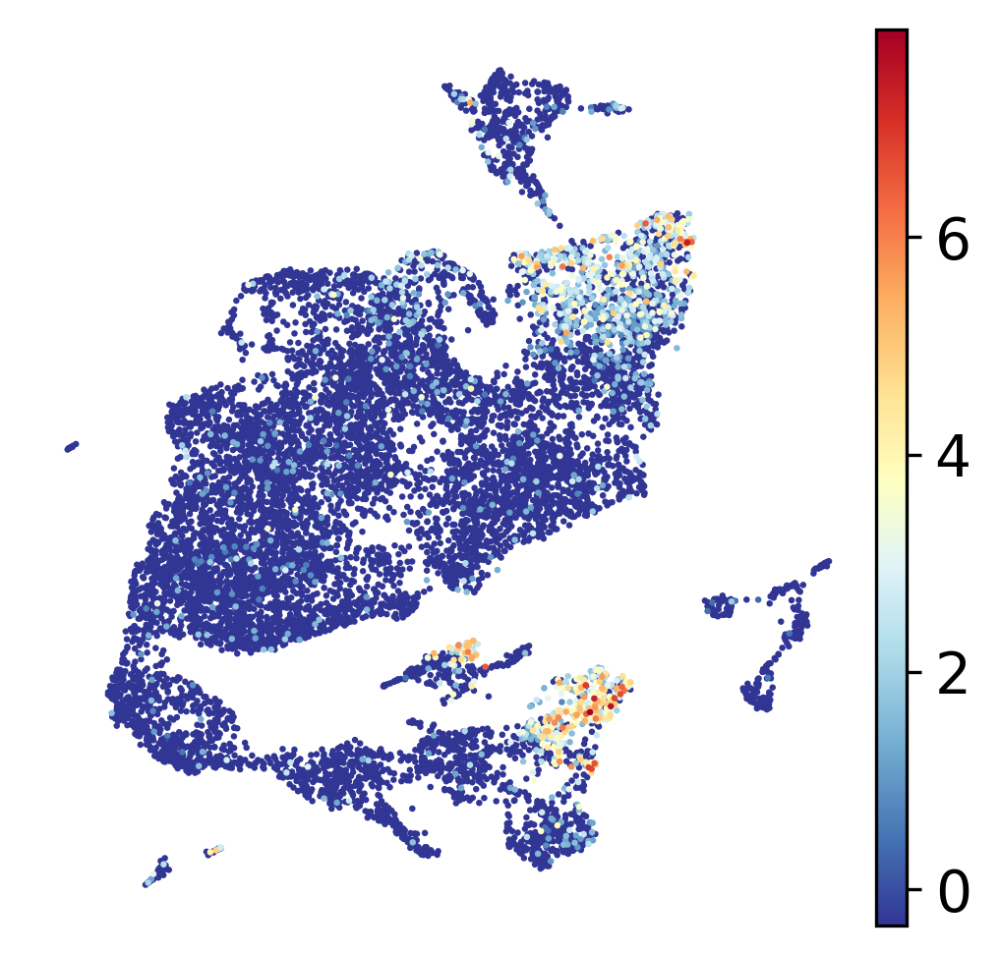

...

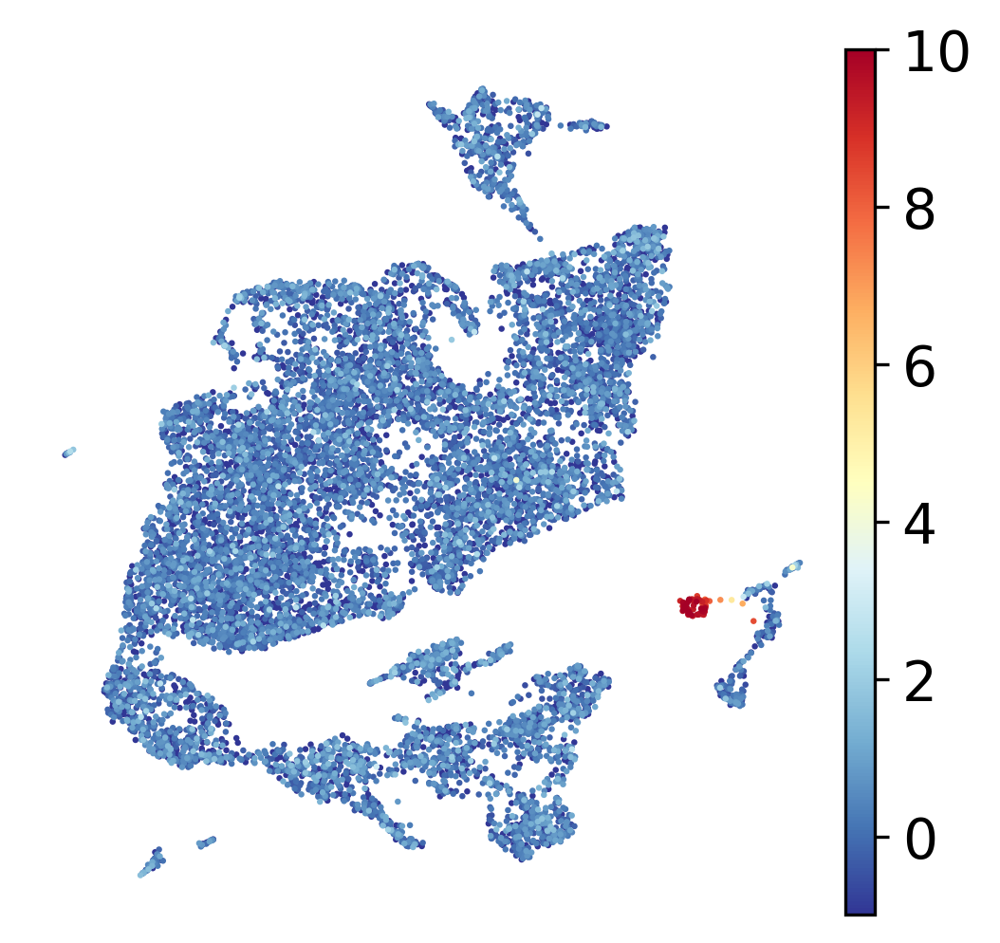

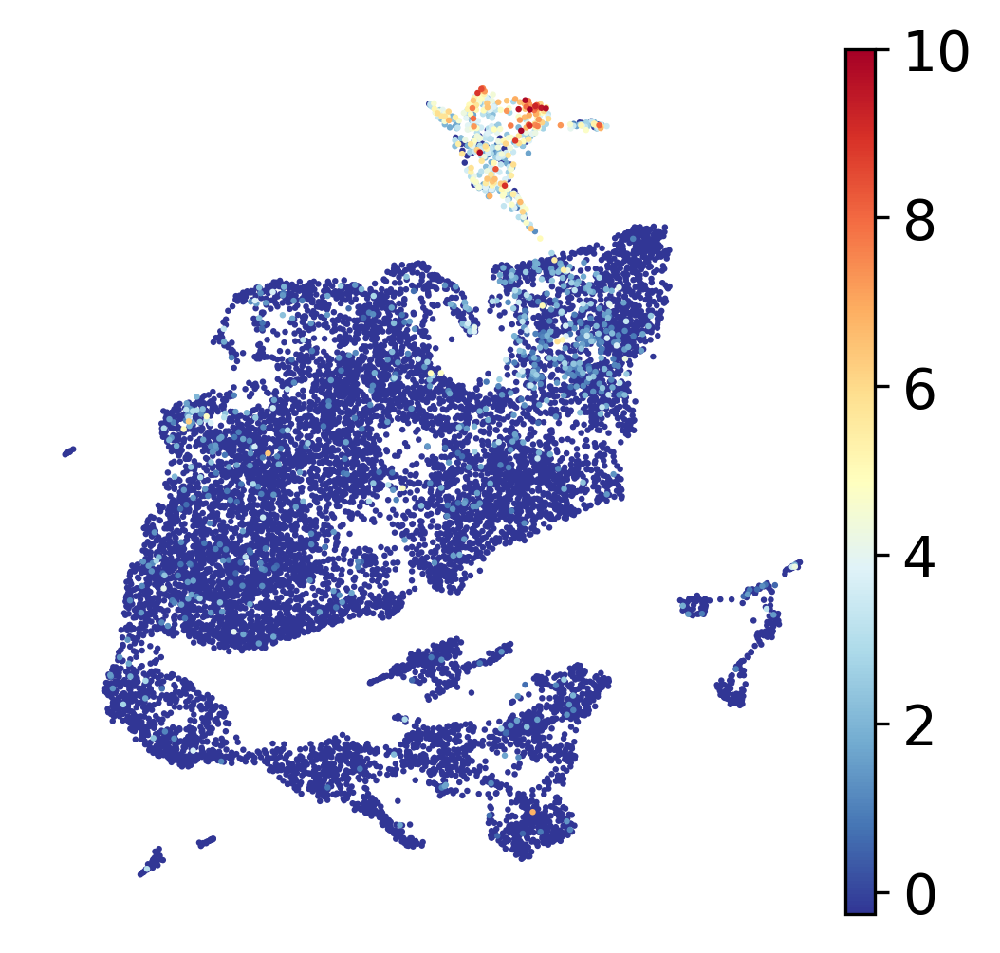

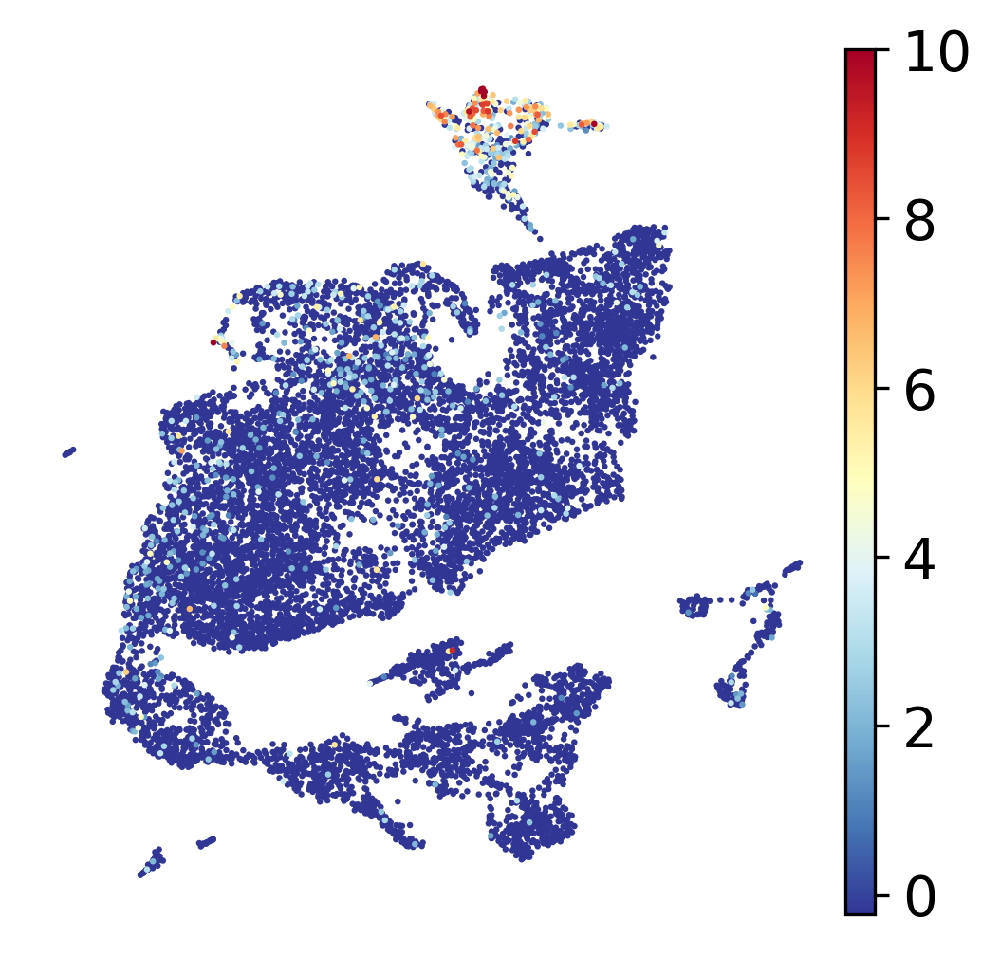

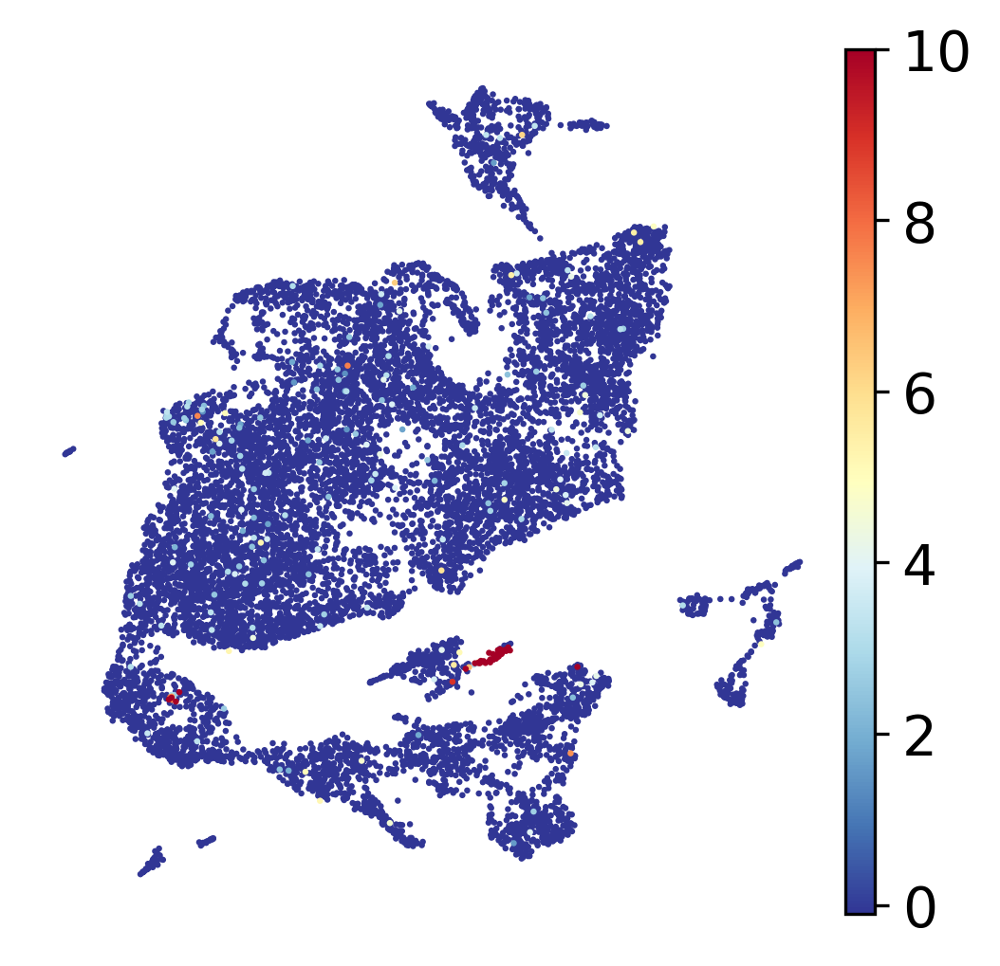

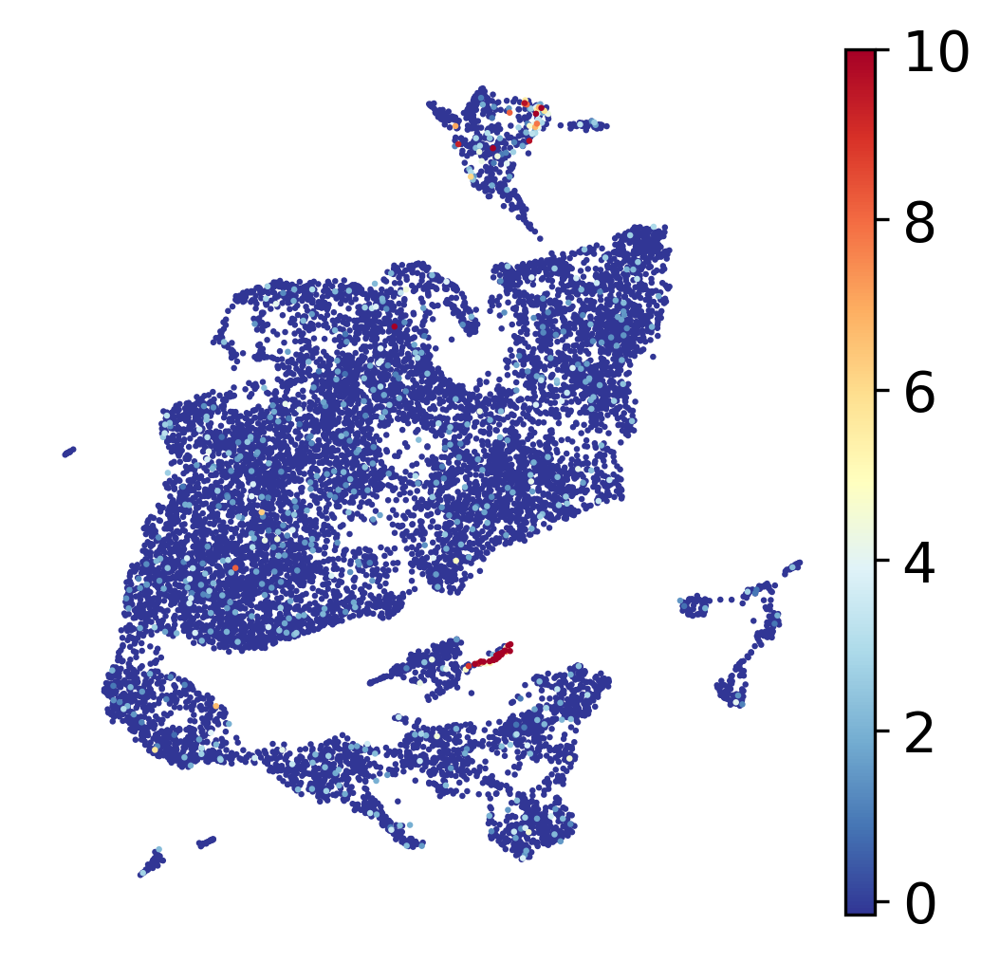

In [41]:
Neural_crest=['MPZ','SOX10']
Neuralepithelial_Cell1= ['SOX2','DLK1','OTX2']
Neuralepithelial_Cell2 = ['RFX4','EGR2']
Neuralepithelial_Cell3 = ['PAX3','CA4']
NMP = ['CDX2','FGF8']
Noto_chord=['T','SHH']
Epithelium=['DLX5','EPCAM']
Mesoderm_Precursor=['TBX6','CITED1']
Presomitic_Mesoderm=['MEOX1','FGF18']
Somite = ['ALDH1A2','MEOX2']
Myocyte_Progenitor=['PITX2','TGFBI']
Lateral_Plate_Mesoderm1=['OSR1','TBX3']
Lateral_Plate_Mesoderm2=['GATA6','COL3A1']
Intermedicate_mdeosderm=['LHX1','PAX8']
Cardiac_Mesoderm=['LUM','PLAT']
Cardiac_Myocyte=['NKX2-5','MYL9']
blood_cell=['HBA1','HBA2']
Endothelium=['KDR','FLT1']
Endoderm= ['APOA2','TTR']

markers=Neural_crest+Neuralepithelial_Cell1+Neuralepithelial_Cell2+Neuralepithelial_Cell3 +NMP+Noto_chord+Epithelium+\
Mesoderm_Precursor+Presomitic_Mesoderm+Somite+Myocyte_Progenitor+Lateral_Plate_Mesoderm1+Lateral_Plate_Mesoderm2+\
Intermedicate_mdeosderm+Cardiac_Mesoderm+Cardiac_Myocyte+blood_cell+Endothelium+Endoderm

paper_figure_dir="/datb/home/wanglab13/PythonScripts/Paper_figures/paper_figures"
for marker in markers:
    if marker in adataw3_1.raw.var_names:
        fig, ax = plt.subplots()
        sc.pl.umap(adataw3_1,color=marker,frameon=False,title='',legend_fontsize=12,show=False,legend_loc='on data',ax=ax,use_raw=False,color_map='RdYlBu_r')
#         plt.savefig("/datb/home/wanglab13/PythonScripts/Paper_figures/paper_figures/FigS3/Figs3_featureplot_{}_v2.pdf".format(marker), dpi=300, format='pdf', bbox_inches='tight')

## Fig4DE

In [2]:
# adataw3_1=sc.read('/newdatb/home/wanglab13/scratch/wholebrain/results/agg_HE-6-3W/scanpy/write/wholebrainw3_v4.h5ad')

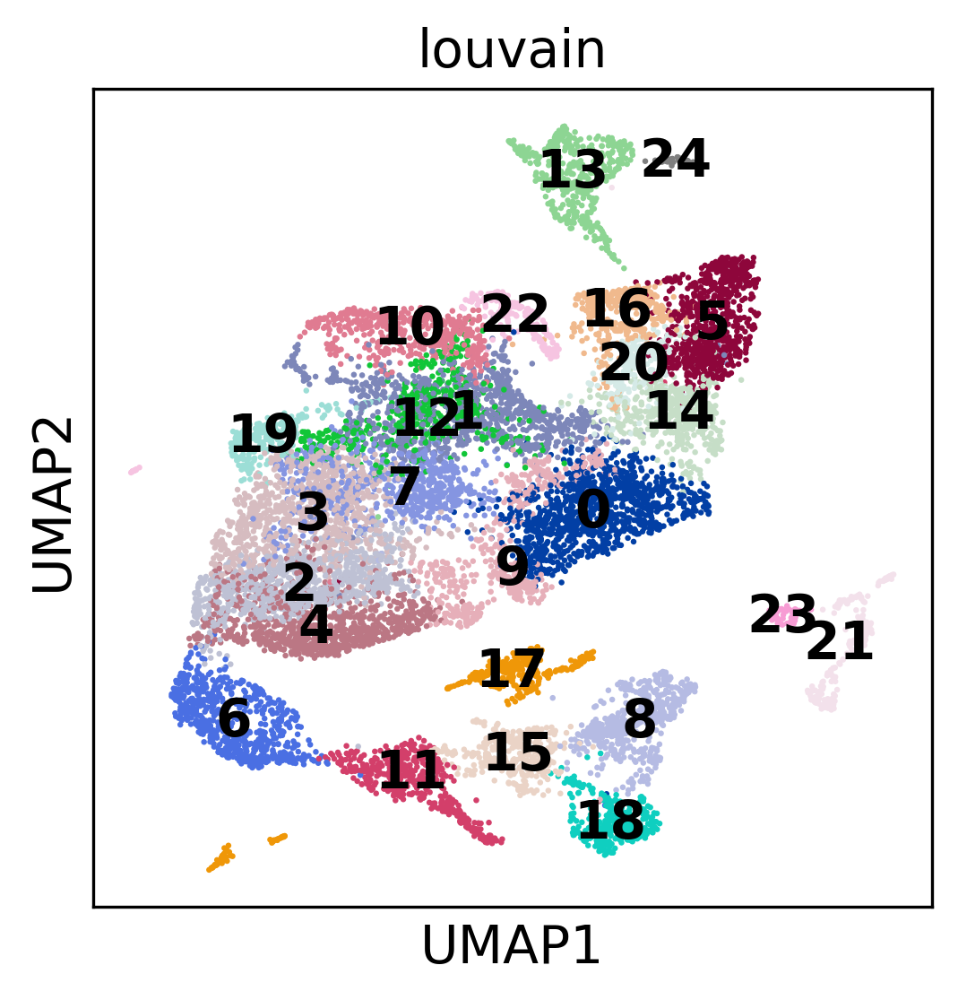

In [42]:
sc.pl.umap(adataw3_1,color='louvain',legend_loc='on data')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 27 clusters and added
    'louvain_foremid', the cluster labels (adata.obs, categorical) (0:00:00)


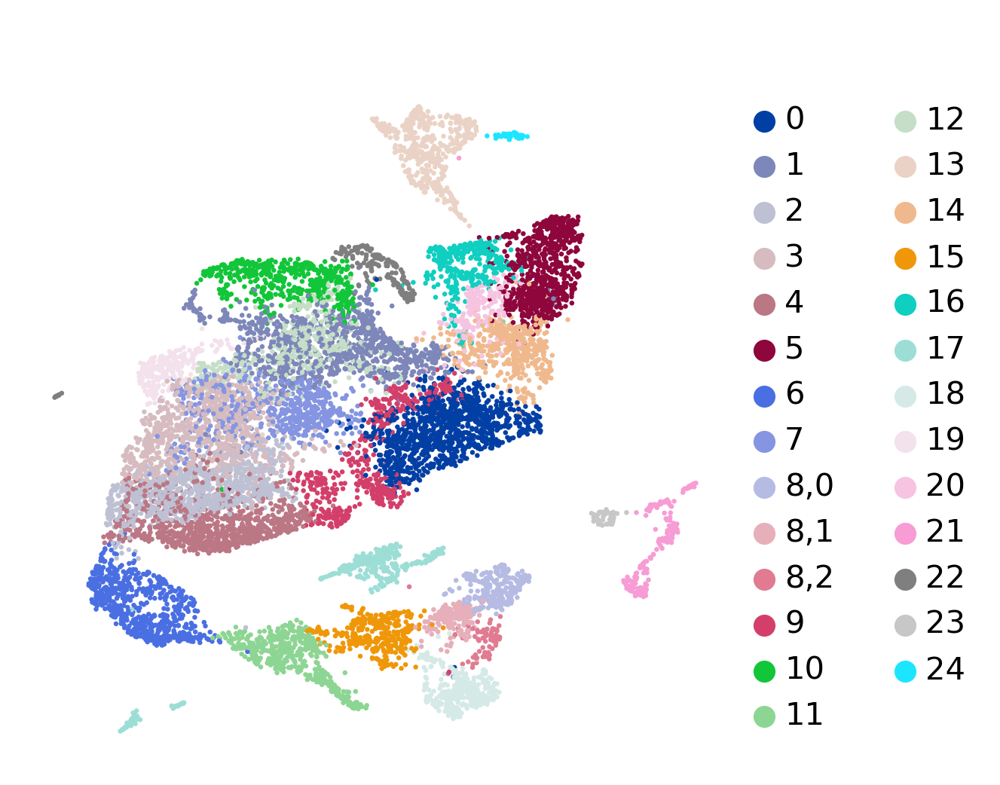

In [43]:
sc.tl.louvain(adataw3_1, restrict_to=('louvain', ['8']), resolution=0.2, key_added='louvain_foremid')
sc.pl.umap(adataw3_1, color=['louvain_foremid'],frameon=False,title=' ',legend_fontsize=10)

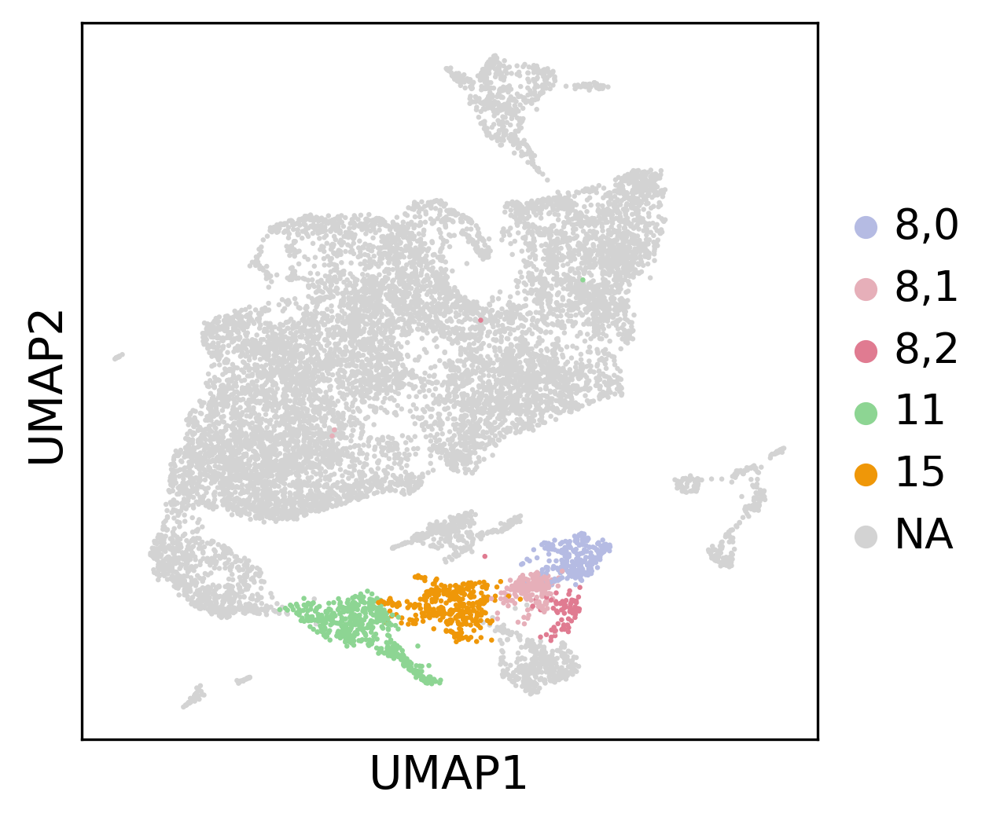

In [44]:
# Show the clusters that will be subsetted
sc.pl.umap(adataw3_1, color='louvain_foremid', edges=False, frameon=True, title='', legend_loc='right margin',
           groups=['11','15','8,0','8,1','8,2'] )   

In [45]:
adata_test = adataw3_1.copy()
adata_test.X = adataw3_1.raw.X

In [46]:
adata_sub = adata_test[adata_test.obs['louvain_foremid'].isin(['11','15','8,0','8,1','8,2'])]
adata_sub

View of AnnData object with n_obs × n_vars = 1343 × 21950
    obs: 'week_stage', 'n_genes', 'percent_mito', 'n_counts', 'louvain', 'clusters_coarse_nonum', 'clusters_coarse', 'clusters_coarse_epi', 'louvain2', 'clusters_coarse_epi_name', 'louvain_foremid'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_coarse_colors', 'clusters_coarse_epi_colors', 'clusters_coarse_epi_name_colors', 'clusters_coarse_nonum_colors', 'louvain', 'louvain2_colors', 'louvain_colors', 'neighbors', 'pca', 'louvain_foremid_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [47]:
map_coarse = {}
for c in adata_sub.obs['louvain_foremid'].cat.categories:
    if c in ['11']:
        map_coarse[c]='SCP'
    if c in ['15']:
        map_coarse[c]='HBP'
    if c in ['8,0']:
        map_coarse[c]='FBP'
    if c in ['8,1','8,2']:
        map_coarse[c]='MBP'
adata_sub.obs['clusters']=adata_sub.obs['louvain_foremid']
adata_sub.obs.replace({'clusters':map_coarse},inplace=True)

Trying to set attribute `.obs` of view, copying.


In [48]:
adata_sub.uns['clusters_colors']=['#1b9e77','#d95f02','#7570b3','#e7298a']

In [49]:
sc.pp.normalize_total(adata_sub)

# Logarithmize the data
sc.pp.log1p(adata_sub)


normalizing counts per cell
    finished (0:00:00)


In [50]:
# Perform PCA and construct neighbor graph
sc.tl.pca(adata_sub, n_comps=20, svd_solver='arpack')
sc.pp.neighbors(adata_sub, n_neighbors=20, n_pcs=20, use_rep='X_pca')
# sc.pp.neighbors(adata_sub) ?
sc.tl.draw_graph(adata_sub, layout='fa', iterations=400, random_state=0) # random_state=0 by default

computing PCA
    on highly variable genes
    with n_comps=20
    finished (0:00:00)
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:03)


In [51]:
adata_sub

AnnData object with n_obs × n_vars = 1343 × 21950
    obs: 'week_stage', 'n_genes', 'percent_mito', 'n_counts', 'louvain', 'clusters_coarse_nonum', 'clusters_coarse', 'clusters_coarse_epi', 'louvain2', 'clusters_coarse_epi_name', 'louvain_foremid', 'clusters'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'clusters_coarse_colors', 'clusters_coarse_epi_colors', 'clusters_coarse_epi_name_colors', 'clusters_coarse_nonum_colors', 'louvain', 'louvain2_colors', 'louvain_colors', 'neighbors', 'pca', 'louvain_foremid_colors', 'clusters_colors', 'log1p', 'draw_graph'
    obsm: 'X_pca', 'X_umap', 'X_draw_graph_fa'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

... storing 'clusters' as categorical


<AxesSubplot:xlabel='FA1', ylabel='FA2'>

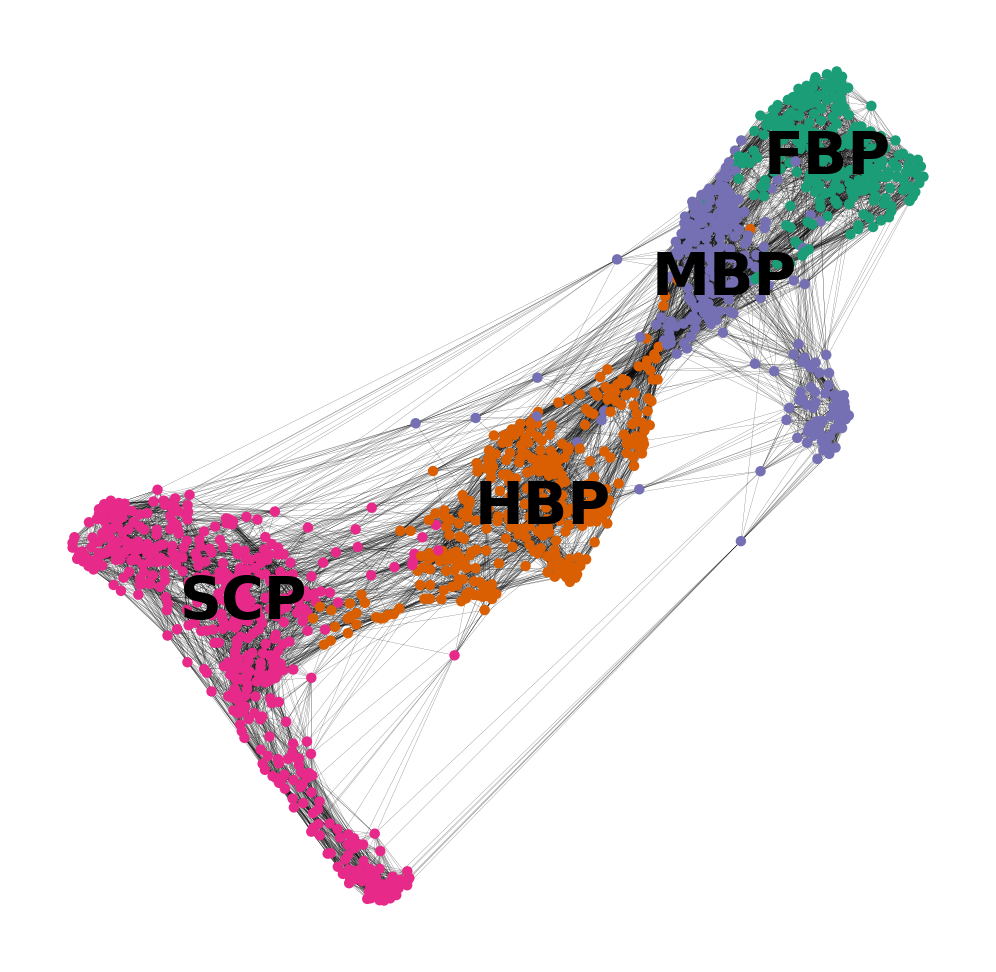

In [52]:
# Plot the ForceAtlas2 graph
import os
paper_figure_dir="/datb/home/wanglab13/PythonScripts/Paper_figures/paper_figures"
fig, ax = plt.subplots()
sc.pl.draw_graph(adata_sub, color='clusters', size=25, edges=True, frameon=False, 
                 edges_color='black',legend_loc='on data', edges_width=0.04,  title = '',ax=ax,show=False)
# plt.savefig("./paper_figures/Fig4/Fig4d_draw_graph_v1.pdf", dpi=300, format='pdf', bbox_inches='tight')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


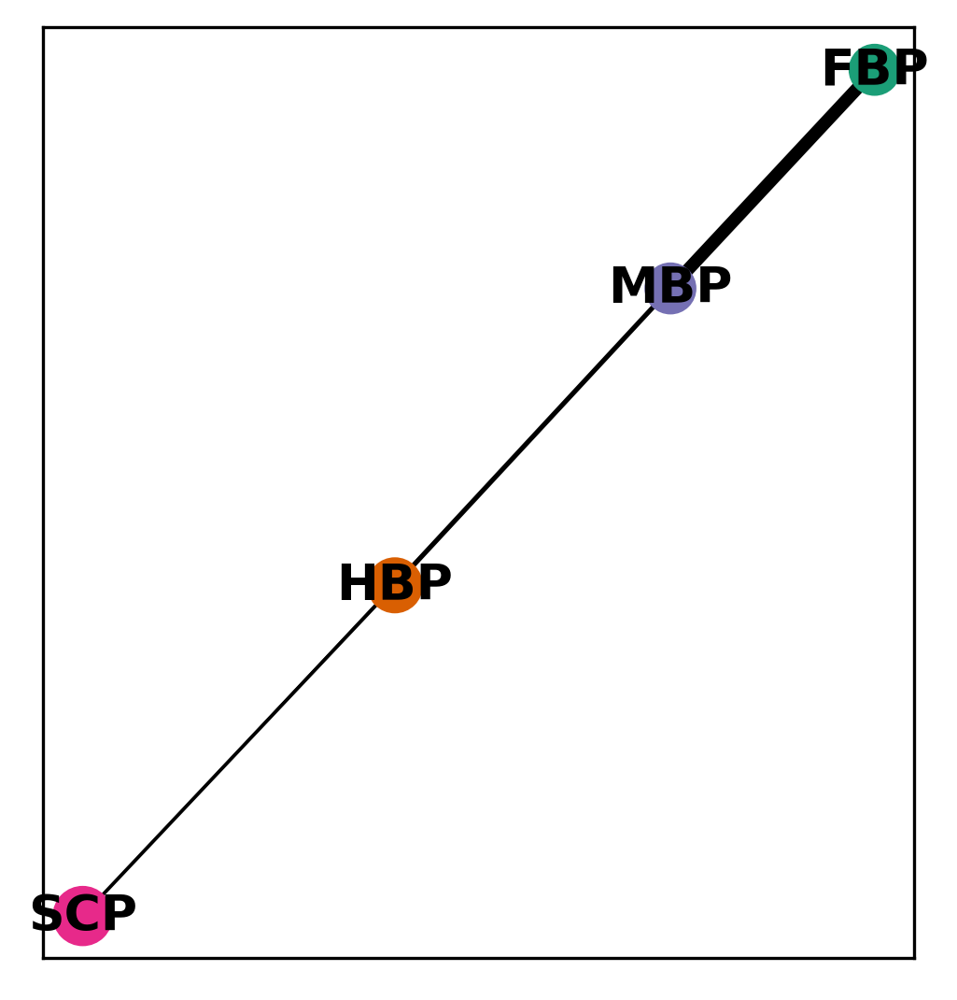

--> added 'pos', the PAGA positions (adata.uns['paga'])


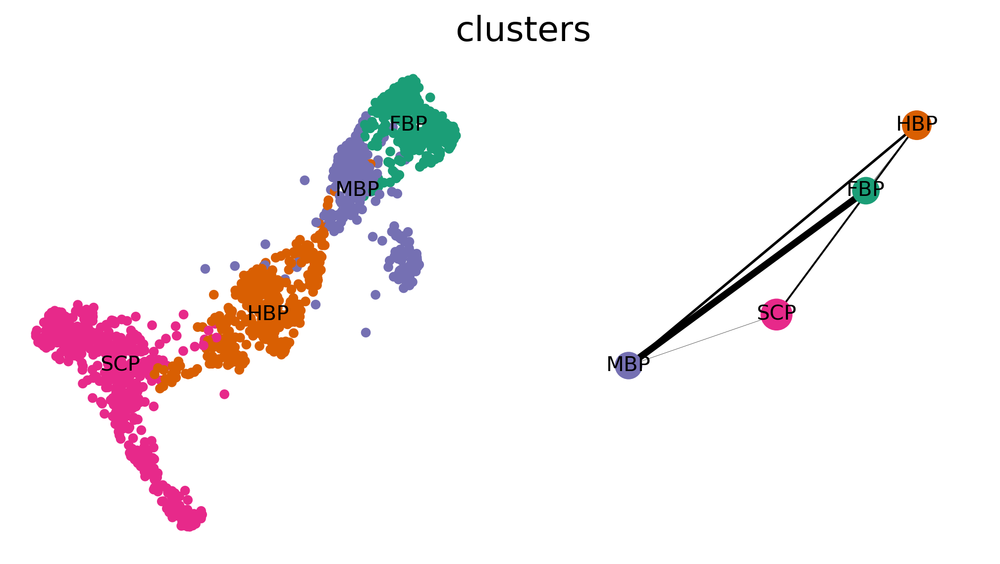

In [53]:
# Get PAGA graph
sc.tl.paga(adata_sub, groups='clusters')
sc.pl.paga(adata_sub, threshold=0.01, edge_width_scale=1)

sc.pl.paga_compare(adata_sub, threshold=0.01, edge_width_scale=1,                  
                   legend_fontsize=10, legend_fontweight='medium')

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.98835456 0.9772775  0.96855354 0.95928746 0.9346752
     0.9229232  0.92156774 0.9063336  0.9037645  0.9013736  0.89999276
     0.88978696 0.8852291  0.87537336]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


(-4716.858532568074, 4229.498307918609, -5264.534631938748, 4551.022836345467)

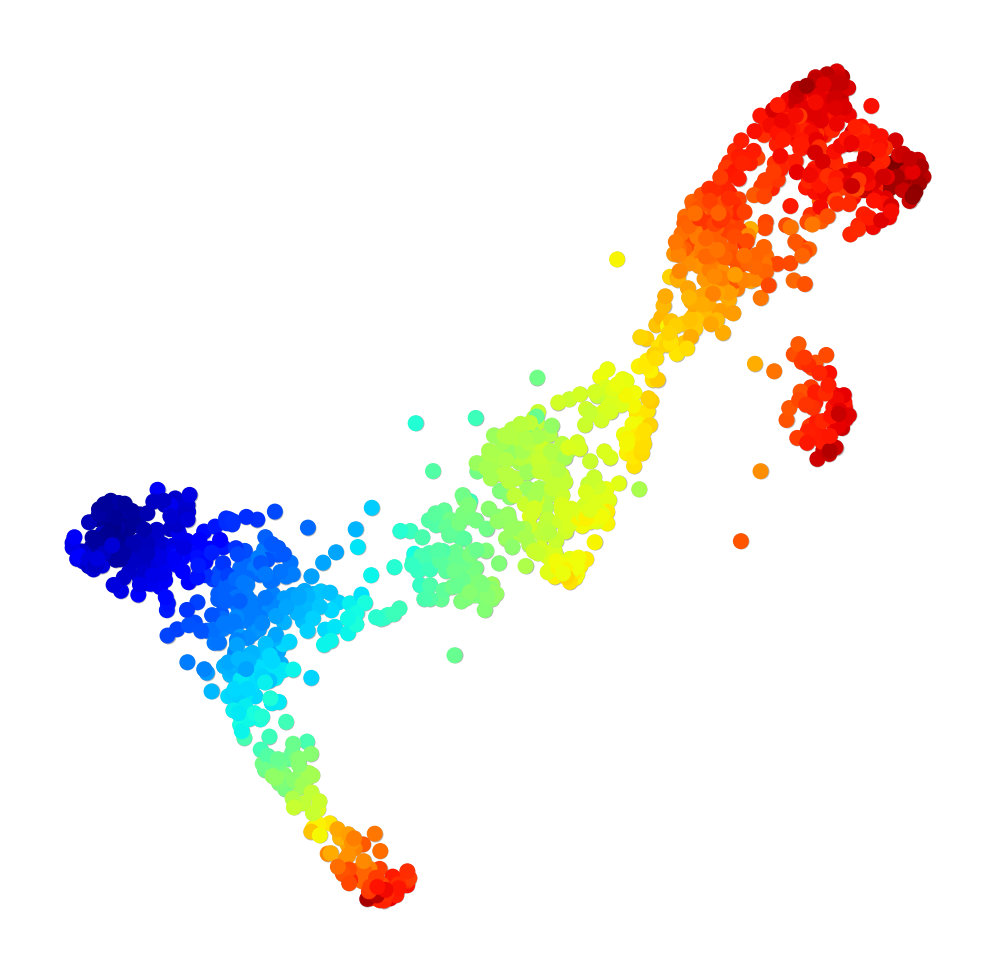

In [54]:
import matplotlib.pyplot as plt
# Calculate dpt pseudotime, starting from the NMP cluster
adata_sub.uns['iroot'] = np.flatnonzero(adata_sub.obs['clusters']  == 'SCP')[0]
sc.tl.diffmap(adata_sub)
sc.tl.dpt(adata_sub)

# Plot DPT values just for the NMP->SOM path
PMflag = adata_sub.obs['clusters'].isin(['SCP','HBP','MBP','FBP'])
fig,ax =plt.subplots(figsize=(4,4))
ax.scatter(adata_sub.obsm['X_draw_graph_fa'][:,0], adata_sub.obsm['X_draw_graph_fa'][:,1], c=[.7,.7,.7], s=8)
ax.scatter(adata_sub.obsm['X_draw_graph_fa'][:,0][PMflag], adata_sub.obsm['X_draw_graph_fa'][:,1][PMflag], 
           c=adata_sub.obs['dpt_pseudotime'][PMflag], cmap='jet', s=8)
ax.set_xticks([]); ax.set_yticks([]);
# ax.set_xlabel('FA1'); ax.set_ylabel('FA2'); ax.set_title('dpt_pseudotime')
ax.set_xlabel(''); ax.set_ylabel(''); ax.set_title('')
ax.axis('off')

In [55]:
fbp_tfs=['THYN1','OTX1','LHX5','HMGA1','MTA3','ZNF280D','HES1','HESX1','FEZF1','SIX3']
mbp_tfs=['YEATS4','PHB','FGF17','FGF8','XBP1','EN1','PAX2','PAX5','PAX8','LITAF','POU5F1','NR2F6','SP5','CAMTA1','OTX2','TEAD2','LIN28A','ID2']
hbp_tfs=['MAFB','ARID5B','SOX3','TSC22D1','EGR2','HOXA2','RFX4','HBP1','KLF6','PIAS1','ZNF706','PEG3','SON','ZNF503','EPHB3','EPHB2','EPHA4','RBPJ']
scp_tfs=['HOXC6','HOXA7','CDX4','CDX1','HOXB9','HOXB8','MSX1','HES6','NEUROG2','HOXB4','ARID3A','HMGB2','HOXB1','HOXA1','ZBTB16','HNF1B'
        ,'LRRFIP2','ID4','PAX3','ATF3','TFAP2A','SOX9',
        'TFAP2B','FOXD3']
brain_genes=scp_tfs+hbp_tfs+mbp_tfs+fbp_tfs

In [56]:
adata_sub_new=sc.AnnData(X=adata_sub.X.A,
                           obs=adata_sub.obs,
                            var=adata_sub.var,
                           uns=adata_sub.uns,
                           obsm=adata_sub.obsm,
                           obsp=adata_sub.obsp)

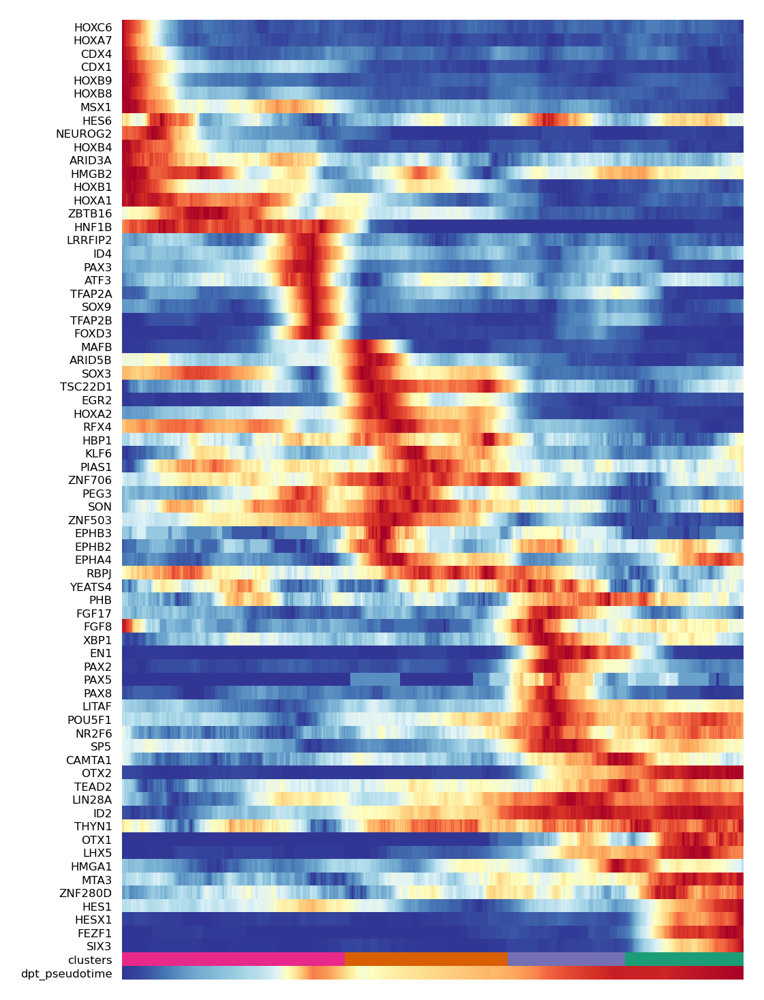

In [57]:
# Plot gene expression trajectories for all dynamic genes
traj_nodes = ['SCP','HBP','MBP','FBP']
fig,ax=plt.subplots(figsize=(4,6))
ax = sc.pl.paga_path(adata_sub_new, nodes=traj_nodes, keys=brain_genes, use_raw=False, annotations=['dpt_pseudotime'],
                     color_map='RdYlBu_r', color_maps_annotations={'dpt_pseudotime': 'RdYlBu_r'}, palette_groups=None, 
                     n_avg=100, groups_key=None, xlim=[None, None], title=None, left_margin=None, ytick_fontsize=4,
                     title_fontsize=None, show_node_names=False, show_yticks=True, show_colorbar=False, 
                     legend_fontsize=1, legend_fontweight=None, normalize_to_zero_one=True, as_heatmap=True,
                     return_data=True, show=False, ax=ax)
# plt.savefig("./paper_figures/Fig4/Fig4f_heatmap_v1.pdf", dpi=300, format='pdf')

In [58]:
df=adata_sub.obs
X_draw_graph_fa_x=adata_sub.obsm['X_draw_graph_fa'][:,0]
x=(X_draw_graph_fa_x-X_draw_graph_fa_x.min())
x=x/x.max()
df['X_draw_graph_fa_x']=x

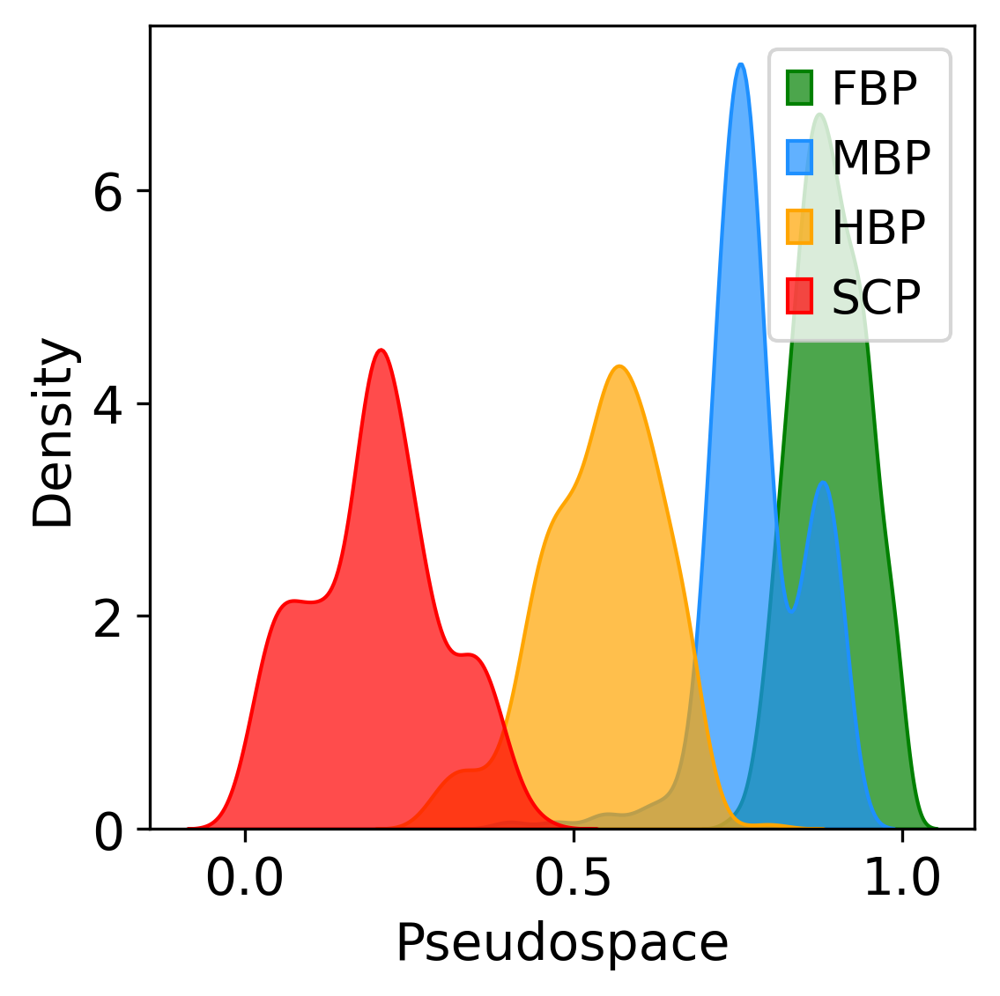

In [59]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure()
sns.kdeplot(df.loc[df['clusters'] == 'FBP', "X_draw_graph_fa_x"], shade=True, color="g", label="FBP", alpha=.7)
sns.kdeplot(df.loc[df['clusters'] == 'MBP', "X_draw_graph_fa_x"], shade=True, color="dodgerblue", label="MBP", alpha=.7)
sns.kdeplot(df.loc[df['clusters'] == 'HBP', "X_draw_graph_fa_x"], shade=True, color="orange", label="HBP", alpha=.7)
sns.kdeplot(df.loc[df['clusters'] == 'SCP', "X_draw_graph_fa_x"], shade=True, color="red", label="SCP", alpha=.7)
plt.xlabel('Pseudospace')
plt.ylabel('Density')
plt.legend()
plt.grid(False)
# plt.savefig("./paper_figures/Fig4/Fig4e_heatmap_v1.pdf", dpi=300, format='pdf')
plt.show()

## FigS4A-D

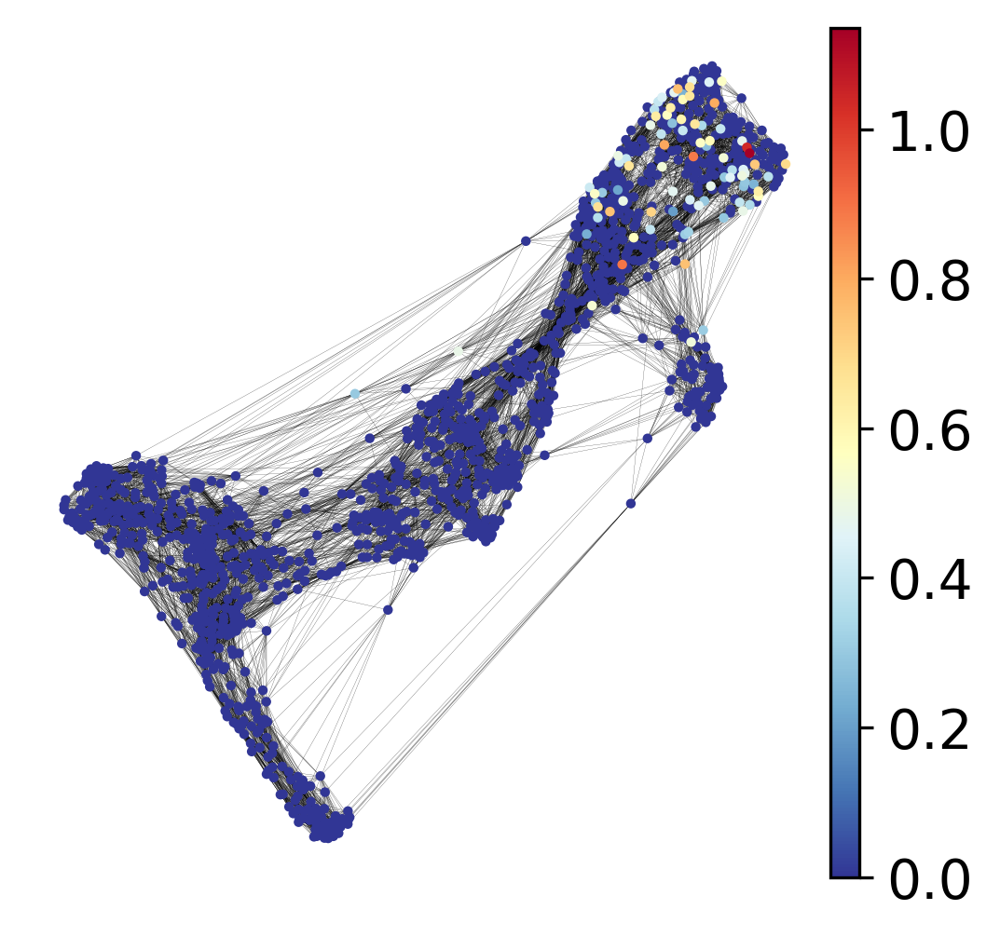

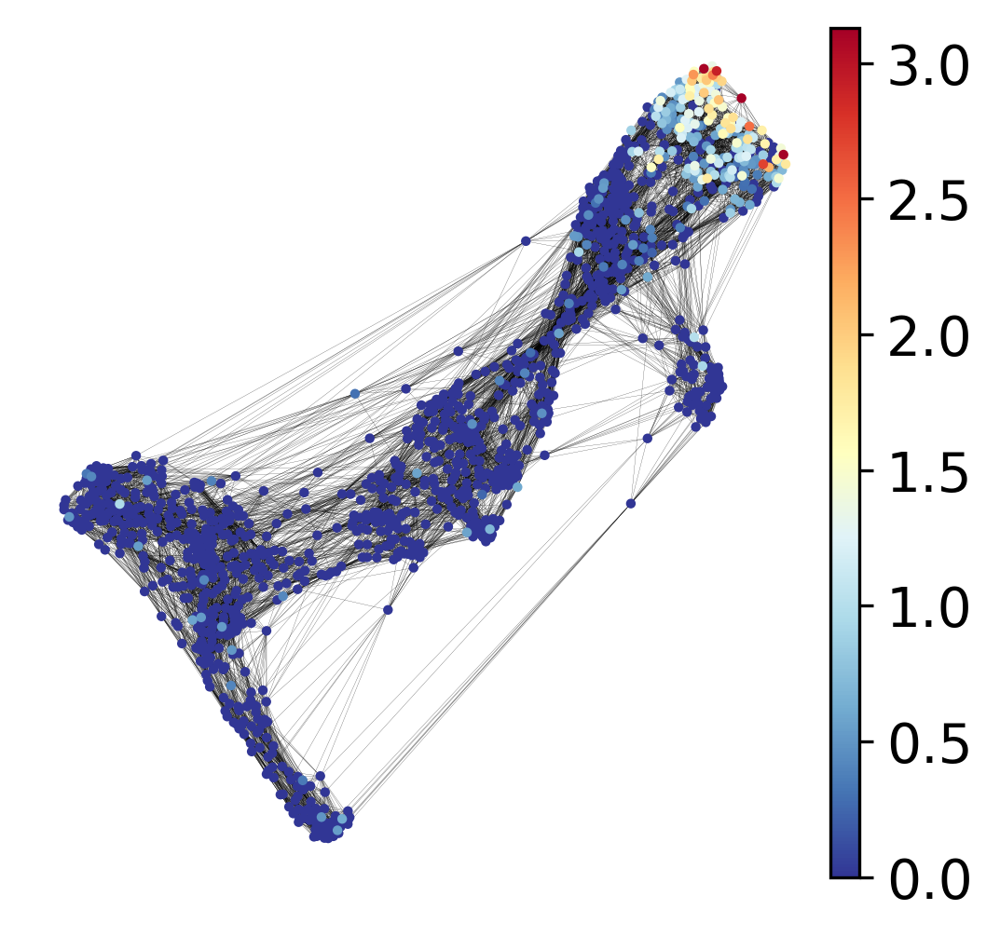

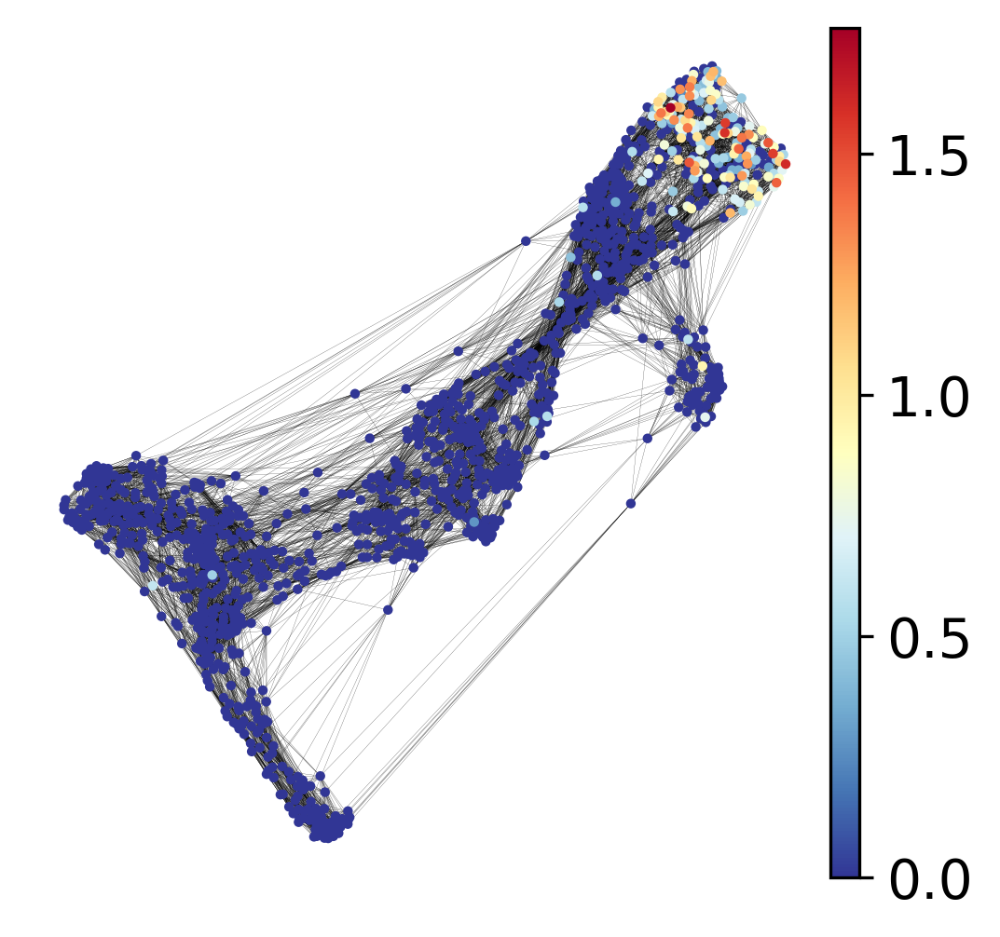

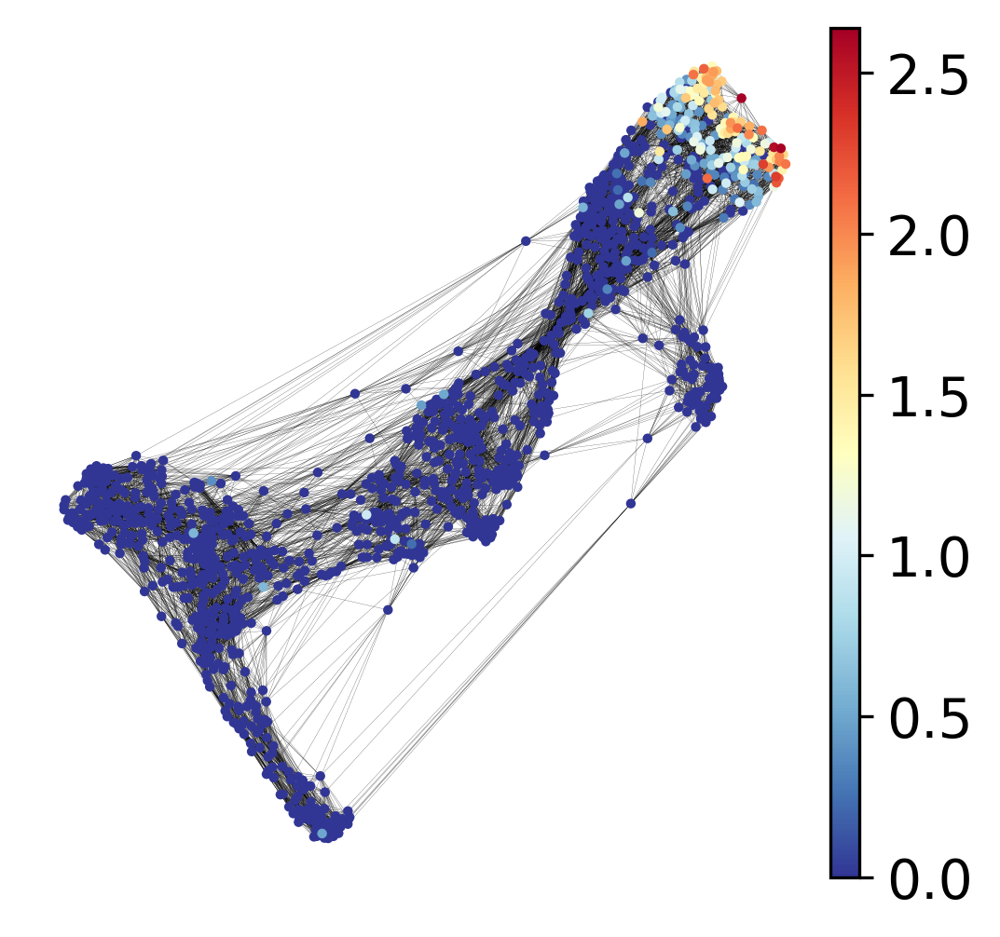

In [60]:
fbp_tfs=['OTX1','HESX1','FEZF1','SIX3']
for gn in fbp_tfs:
    sc.pl.draw_graph(adata_sub, color=gn, size=25, edges=True, frameon=False, color_map='RdYlBu_r',
                     edges_color='black',legend_loc='on data', edges_width=0.05,  title = '',show=False)
#     plt.savefig("./paper_figures/FigS6/FigS6_FB_feature_plot_{}_v1.pdf".format(gn), dpi=300, format='pdf', bbox_inches='tight')

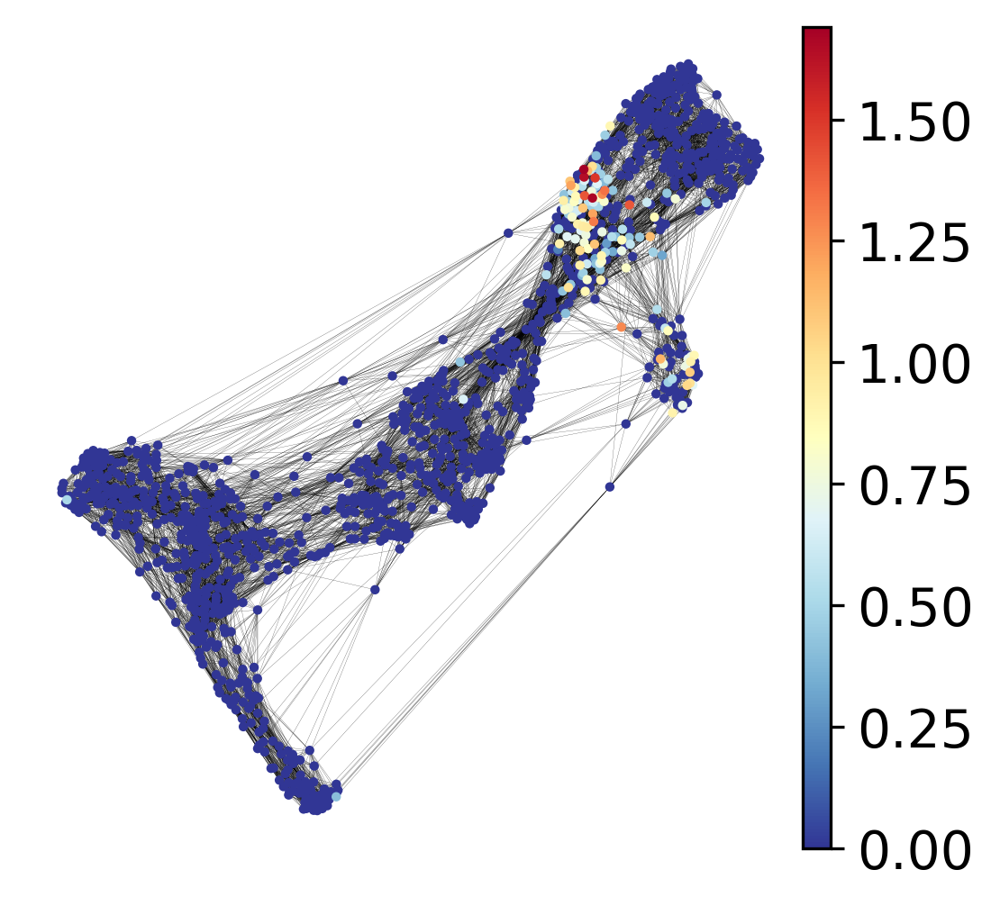

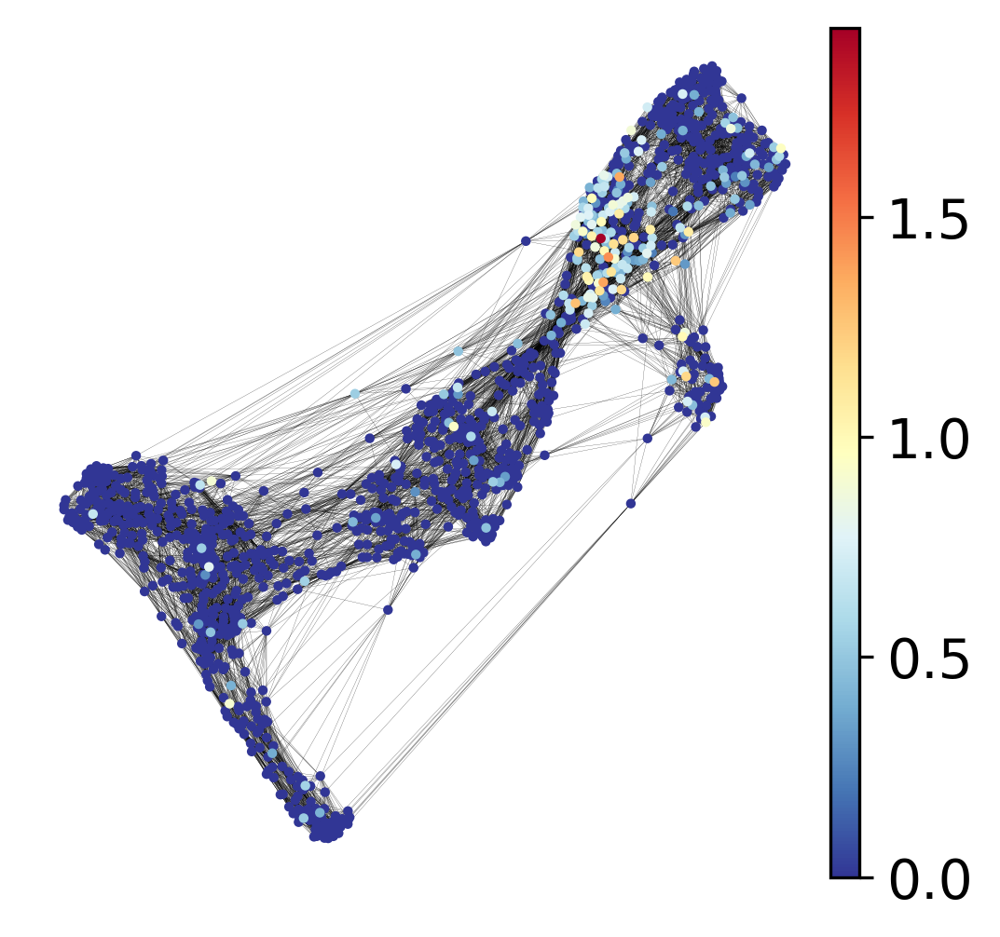

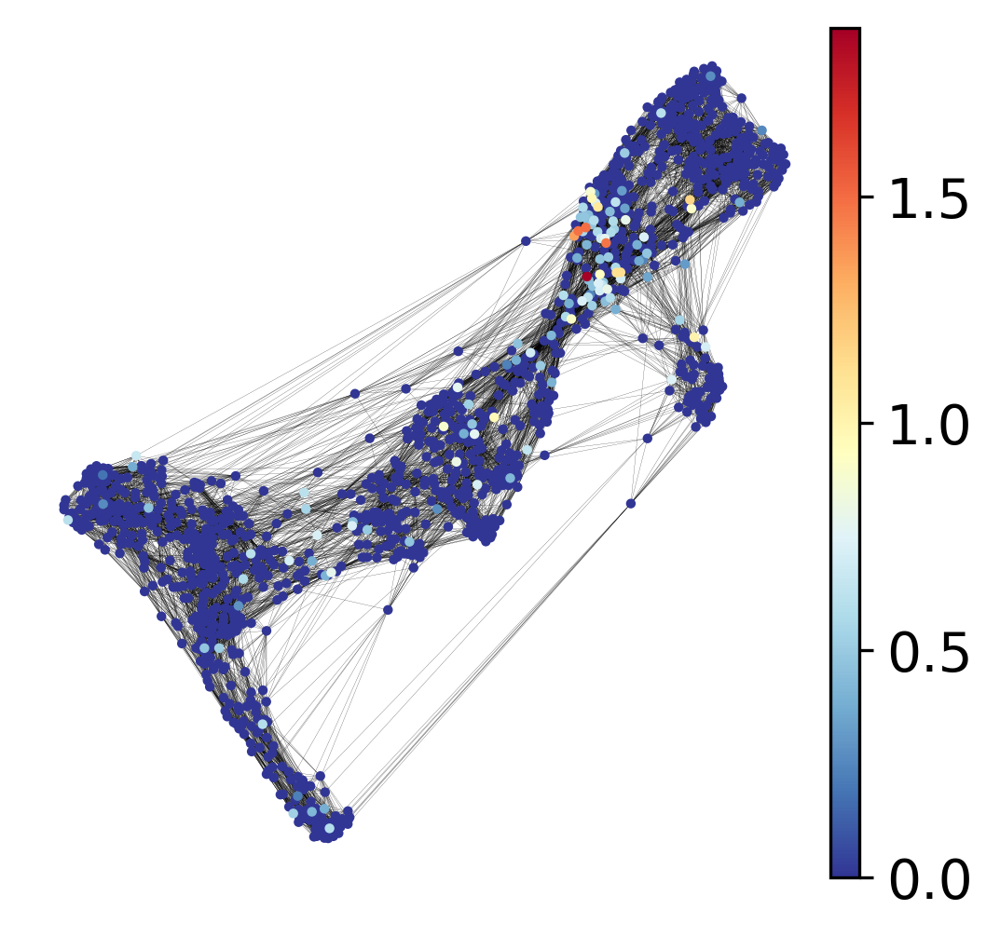

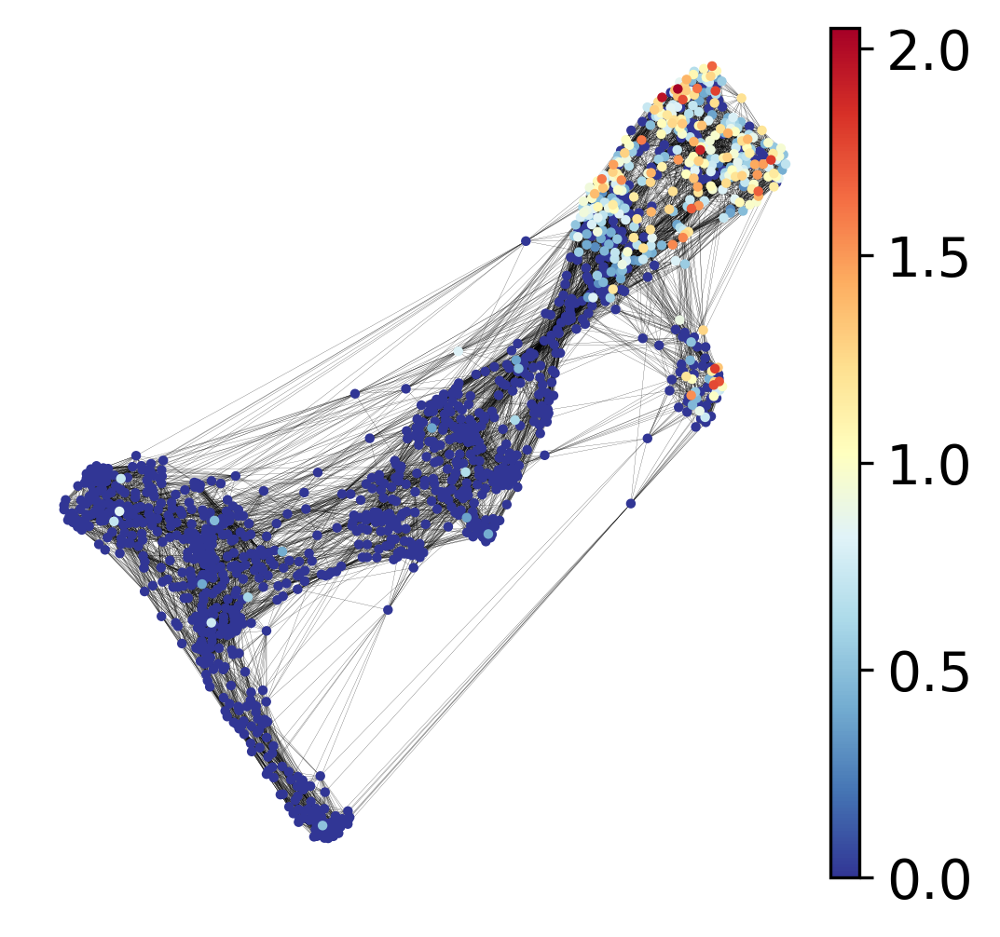

In [61]:
# mbp_tfs=['YEATS4','PHB','FGF17','FGF8','XBP1','EN1','PAX2','PAX5','PAX8','LITAF','POU5F1','NR2F6','SP5','CAMTA1','OTX2','TEAD2','LIN28A','ID2']
mbp_tfs=['EN1','PAX2','PAX8','OTX2']
for gn in mbp_tfs:
    sc.pl.draw_graph(adata_sub, color=gn, size=25, edges=True, frameon=False, color_map='RdYlBu_r',
                     edges_color='black',legend_loc='on data', edges_width=0.05,  title = '',show=False)
#     plt.savefig("./paper_figures/FigS6/FigS6_MB_feature_plot_{}_v1.pdf".format(gn), dpi=300, format='pdf', bbox_inches='tight')

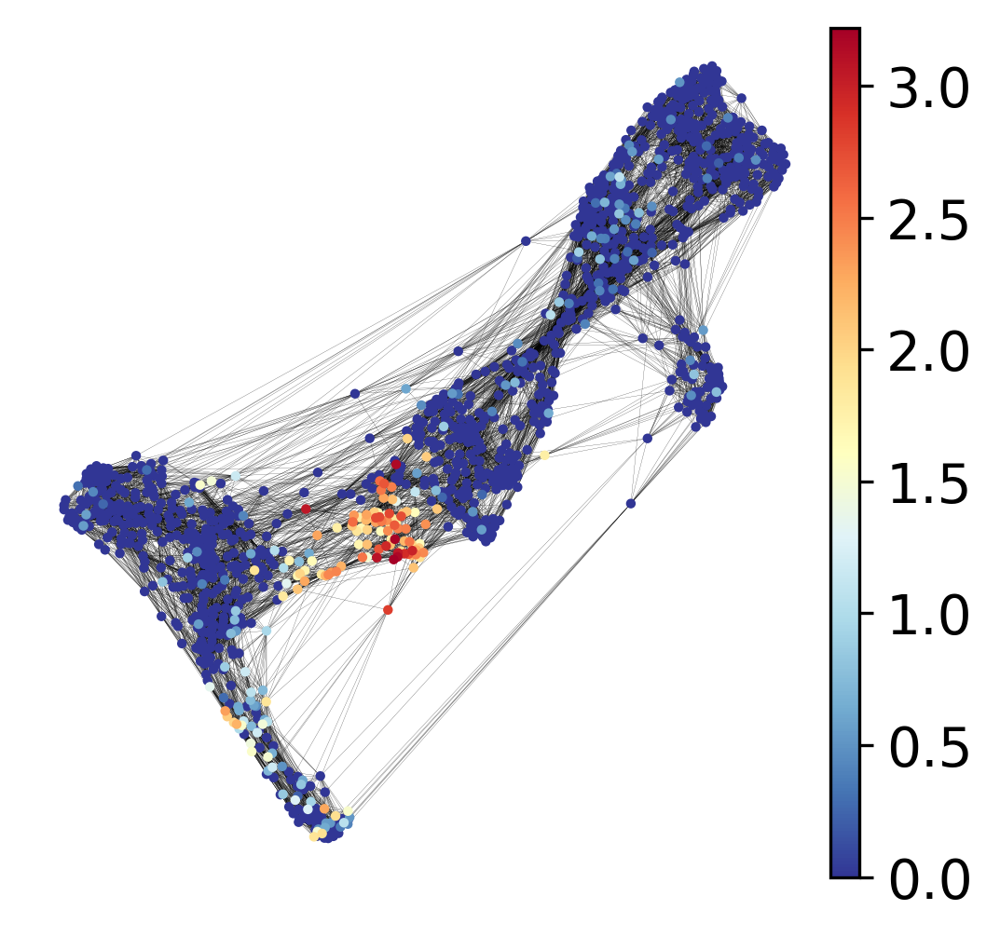

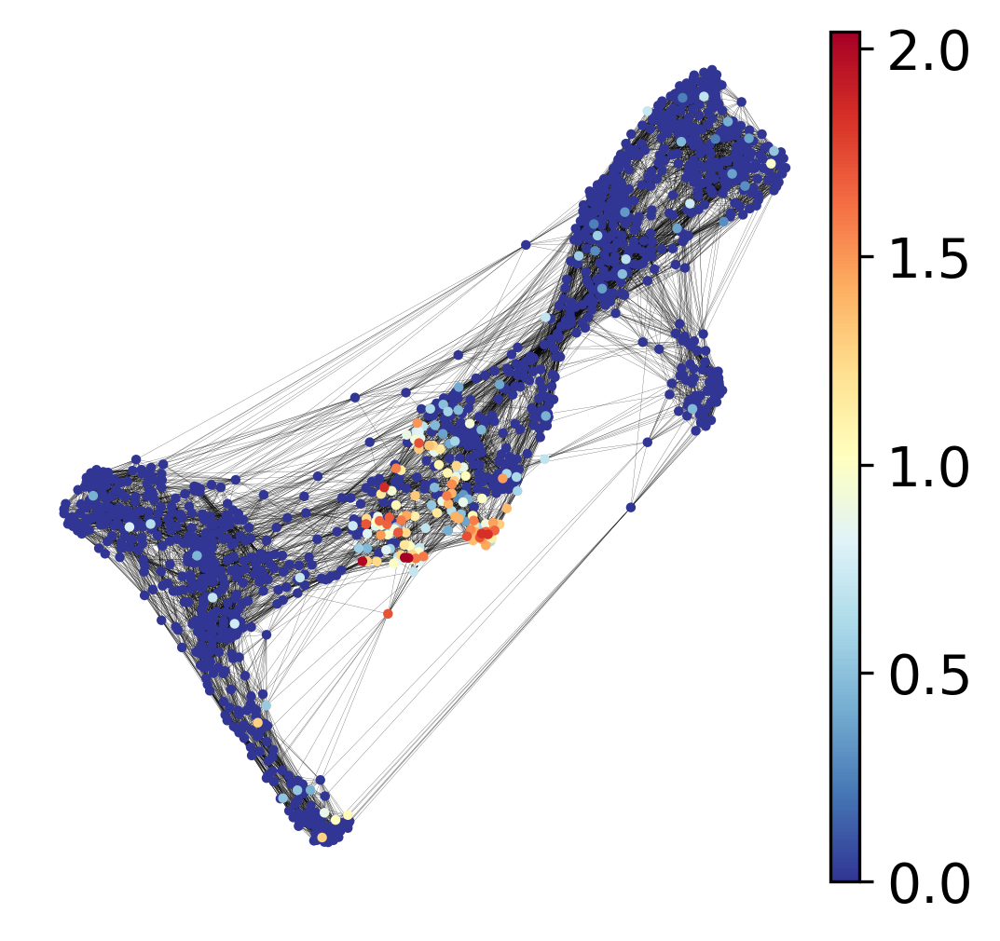

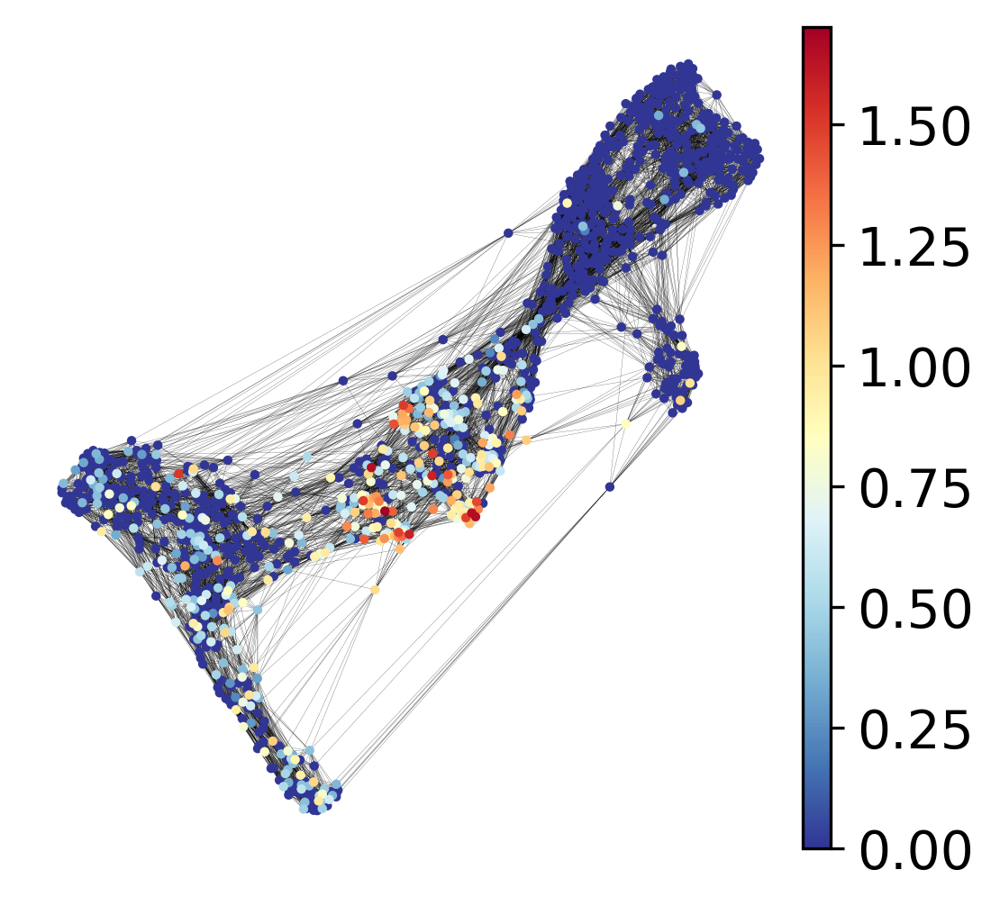

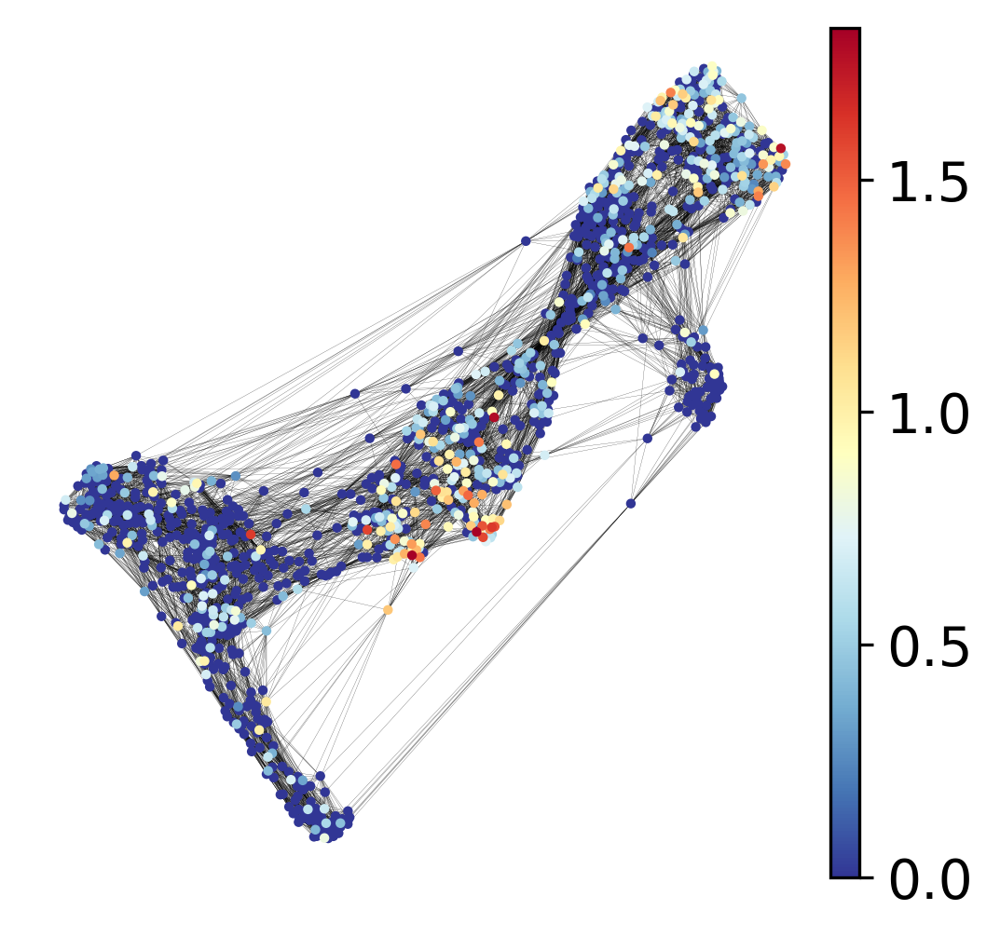

In [62]:
hbp_tfs=['MAFB','EGR2','HOXA2','EPHA4']
for gn in hbp_tfs:
    sc.pl.draw_graph(adata_sub, color=gn, size=25, edges=True, frameon=False, color_map='RdYlBu_r',
                     edges_color='black',legend_loc='on data', edges_width=0.05,  title = '',show=False)
#     plt.savefig("./paper_figures/FigS6/FigS6_HB_feature_plot_{}_v1.pdf".format(gn), dpi=300, format='pdf', bbox_inches='tight')

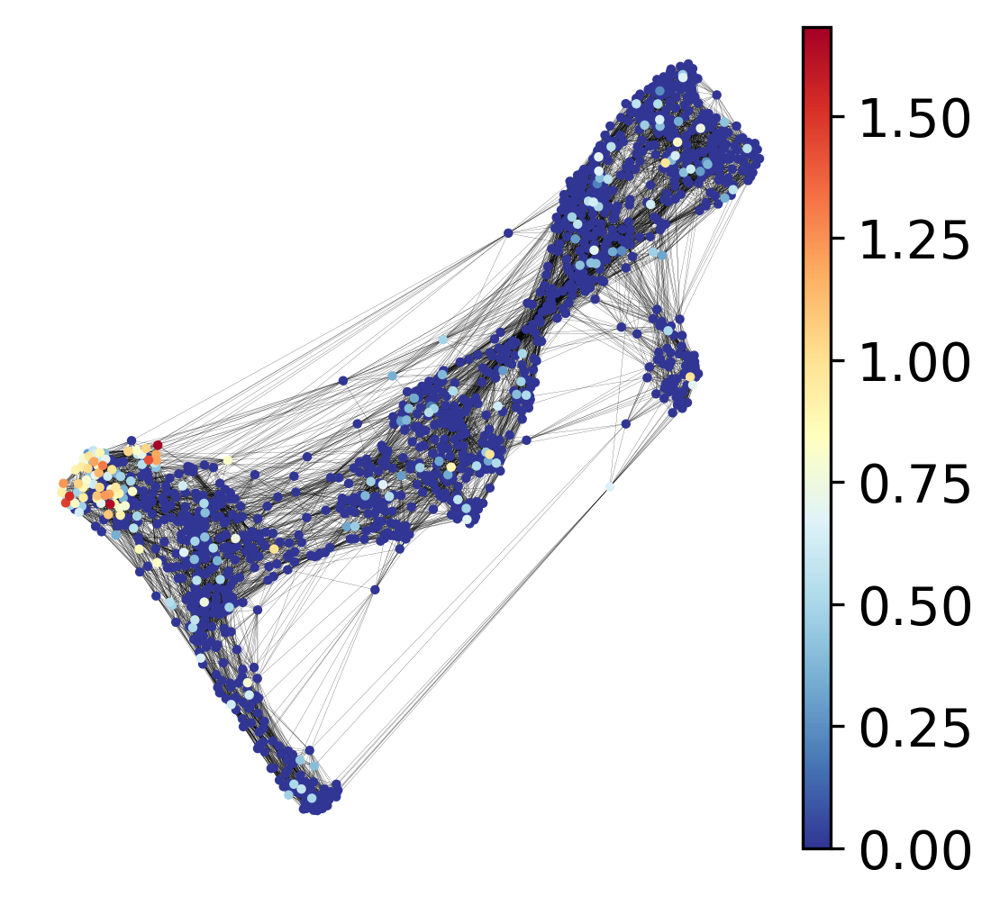

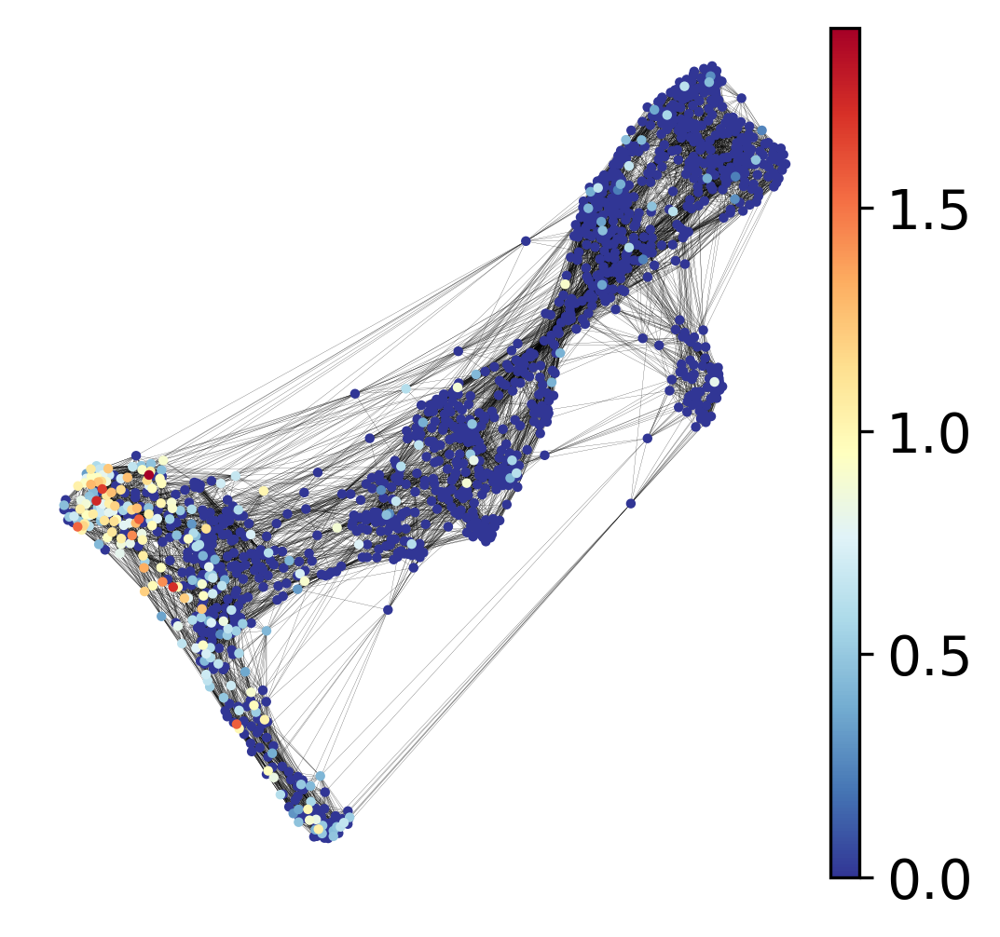

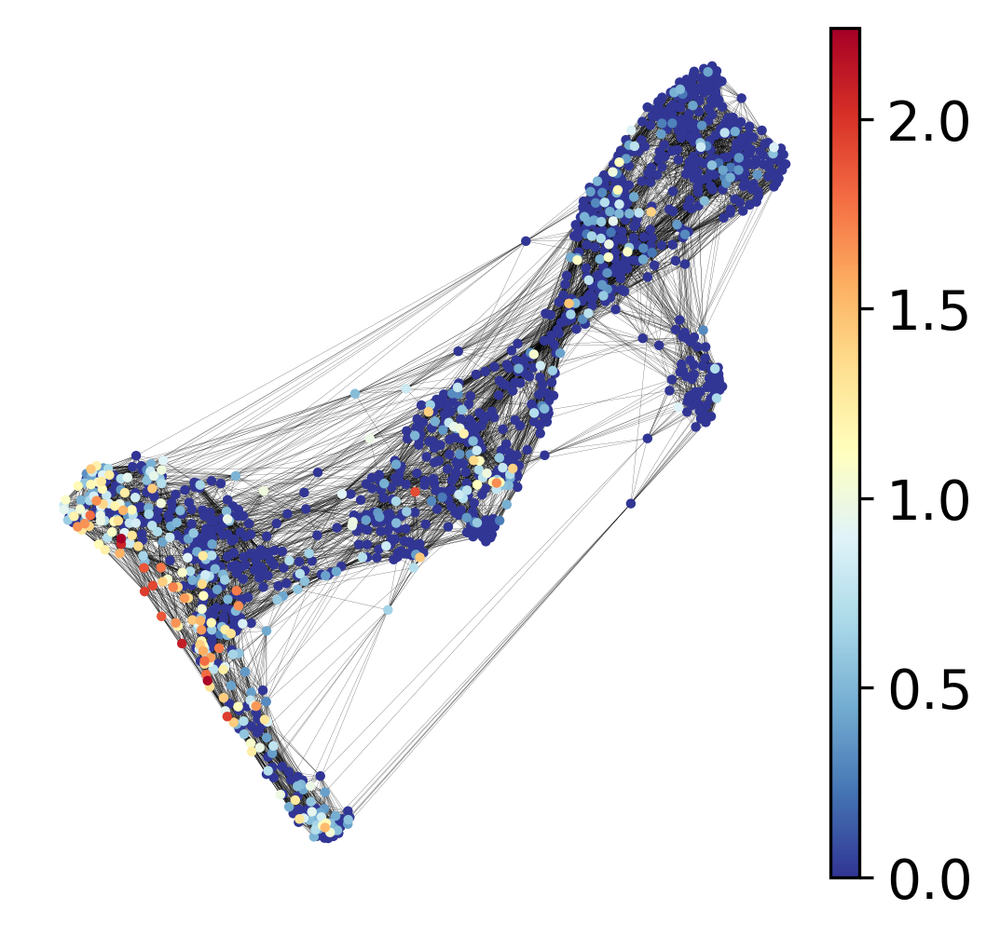

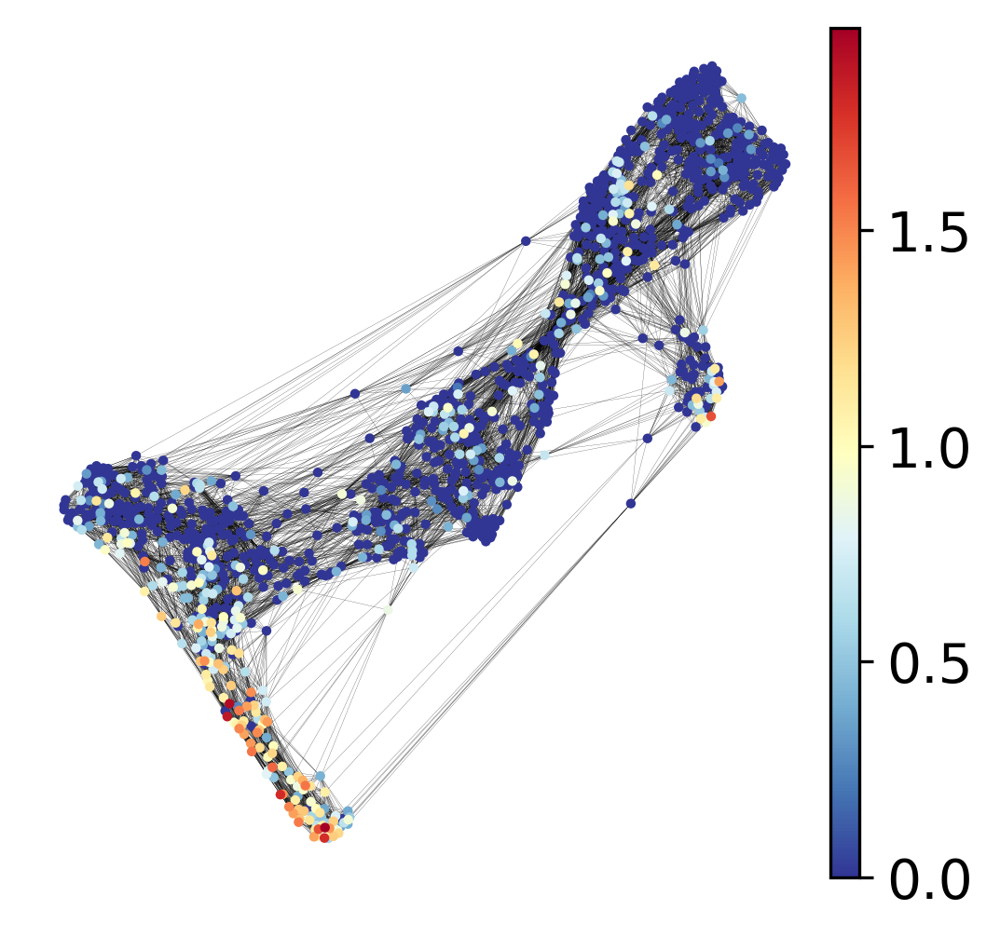

In [63]:
scp_tfs=['HOXC6','CDX1','MSX1','PAX3']
for gn in scp_tfs:
    sc.pl.draw_graph(adata_sub, color=gn, size=25, edges=True, frameon=False, color_map='RdYlBu_r',
                     edges_color='black',legend_loc='on data', edges_width=0.05,  title = '',show=False)
#     plt.savefig("./paper_figures/FigS6/FigS6_SCP_feature_plot_{}_v1.pdf".format(gn), dpi=300, format='pdf', bbox_inches='tight')

In [64]:
adata_sub.write("/datb/home/wanglab13/scratch/wholebrain/results/adata_w3_1_brain.h5ad")